# Practice Project 8_FlightPricePrediction

# Problem Statement

# Flight Price Prediction is a regression based problem statement to predict flight ticket prices based on prices of flight tickets for various airlines between the months of March and June of 2019 and between various cities. There is a train dataset and a test dataset.

# Importing Data From Github repository:
# dsrscientist/Data-Science-ML-Capstone-Projects

In [1]:
import pandas as pd
data=pd.read_excel('C:/Users/Lenovo/Downloads/Flight_Ticket_Participant_Datasets-20190305T100527Z-001/Flight_Ticket_Participant_Datasets/Data_Train.xlsx')
test_data=pd.read_excel('C:/Users/Lenovo/Downloads/Flight_Ticket_Participant_Datasets-20190305T100527Z-001/Flight_Ticket_Participant_Datasets/Test_set.xlsx')
data

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302
...,...,...,...,...,...,...,...,...,...,...,...
10678,Air Asia,9/04/2019,Kolkata,Banglore,CCU → BLR,19:55,22:25,2h 30m,non-stop,No info,4107
10679,Air India,27/04/2019,Kolkata,Banglore,CCU → BLR,20:45,23:20,2h 35m,non-stop,No info,4145
10680,Jet Airways,27/04/2019,Banglore,Delhi,BLR → DEL,08:20,11:20,3h,non-stop,No info,7229
10681,Vistara,01/03/2019,Banglore,New Delhi,BLR → DEL,11:30,14:10,2h 40m,non-stop,No info,12648


# The above table represents first 5 and last 5 rows of the dataframe.

# Data Visualization

In [2]:
print('DataFrame View: ')
print('View 1: Head View: ', end='\n'*2)
print(data.head(), end='\n'*2)
print('View 2: Sample View: ', end='\n'*2)
print(data.sample(), end='\n'*2)
print('View 3: Tail View: ', end='\n'*2)
print(data.tail(), end='\n'*2)

DataFrame View: 
View 1: Head View: 

       Airline Date_of_Journey    Source Destination                  Route  \
0       IndiGo      24/03/2019  Banglore   New Delhi              BLR → DEL   
1    Air India       1/05/2019   Kolkata    Banglore  CCU → IXR → BBI → BLR   
2  Jet Airways       9/06/2019     Delhi      Cochin  DEL → LKO → BOM → COK   
3       IndiGo      12/05/2019   Kolkata    Banglore        CCU → NAG → BLR   
4       IndiGo      01/03/2019  Banglore   New Delhi        BLR → NAG → DEL   

  Dep_Time  Arrival_Time Duration Total_Stops Additional_Info  Price  
0    22:20  01:10 22 Mar   2h 50m    non-stop         No info   3897  
1    05:50         13:15   7h 25m     2 stops         No info   7662  
2    09:25  04:25 10 Jun      19h     2 stops         No info  13882  
3    18:05         23:30   5h 25m      1 stop         No info   6218  
4    16:50         21:35   4h 45m      1 stop         No info  13302  

View 2: Sample View: 

      Airline Date_of_Journey   Sourc

# The above print statements, display first 5 rows; a random row and last 5 rows of the dataframe.

# Data Cleaning

In [3]:
data.columns

Index(['Airline', 'Date_of_Journey', 'Source', 'Destination', 'Route',
       'Dep_Time', 'Arrival_Time', 'Duration', 'Total_Stops',
       'Additional_Info', 'Price'],
      dtype='object')

# The above cell represent all the columns of the data to check for missing column and incorrect column.

In [4]:
data.shape

(10683, 11)

# The above cell displays dimensions of data: 10683 rows * 11 columns.

In [5]:
type(data), type(data.columns)

(pandas.core.frame.DataFrame, pandas.core.indexes.base.Index)

# Type of data and data columns.

In [6]:
data.isnull().sum()

Airline            0
Date_of_Journey    0
Source             0
Destination        0
Route              1
Dep_Time           0
Arrival_Time       0
Duration           0
Total_Stops        1
Additional_Info    0
Price              0
dtype: int64

In [7]:
data.isna().values.any()

True

# As per above cells there are 2 missing values, one in route and one in total_stops.

# Handling Of Missing Data

In [8]:
data=data.fillna(method='backfill')
data

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302
...,...,...,...,...,...,...,...,...,...,...,...
10678,Air Asia,9/04/2019,Kolkata,Banglore,CCU → BLR,19:55,22:25,2h 30m,non-stop,No info,4107
10679,Air India,27/04/2019,Kolkata,Banglore,CCU → BLR,20:45,23:20,2h 35m,non-stop,No info,4145
10680,Jet Airways,27/04/2019,Banglore,Delhi,BLR → DEL,08:20,11:20,3h,non-stop,No info,7229
10681,Vistara,01/03/2019,Banglore,New Delhi,BLR → DEL,11:30,14:10,2h 40m,non-stop,No info,12648


In [9]:
data.isna().any()

Airline            False
Date_of_Journey    False
Source             False
Destination        False
Route              False
Dep_Time           False
Arrival_Time       False
Duration           False
Total_Stops        False
Additional_Info    False
Price              False
dtype: bool

# In the above cells, I have filled missing values with backfill method and then checked for missing values and found no missing values this time.

# Handling Incorrect Data

In [11]:
data['Additional_Info'].unique()

array(['No info', 'In-flight meal not included',
       'No check-in baggage included', '1 Short layover', 'No Info',
       '1 Long layover', 'Change airports', 'Business class',
       'Red-eye flight', '2 Long layover'], dtype=object)

In [13]:
import numpy as np
data['Additional_Info']=np.where(data['Additional_Info']=='No info', 'No Info', data['Additional_Info'])
data['Additional_Info'].unique()

array(['No Info', 'In-flight meal not included',
       'No check-in baggage included', '1 Short layover',
       '1 Long layover', 'Change airports', 'Business class',
       'Red-eye flight', '2 Long layover'], dtype=object)

# As part of data pre processing, changed No info to No Info, it was present in 2 ways: No info and No Info... Now only No Info can be seen in the data for better comparison.

# Tabulated Conclusion Of Data Cleaning

In [14]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10683 non-null  object
 1   Date_of_Journey  10683 non-null  object
 2   Source           10683 non-null  object
 3   Destination      10683 non-null  object
 4   Route            10683 non-null  object
 5   Dep_Time         10683 non-null  object
 6   Arrival_Time     10683 non-null  object
 7   Duration         10683 non-null  object
 8   Total_Stops      10683 non-null  object
 9   Additional_Info  10683 non-null  object
 10  Price            10683 non-null  int64 
dtypes: int64(1), object(10)
memory usage: 918.2+ KB


# Verbal Translation Of Conclusion Of Above Data Cleaning Process

# Conclusion:
1. The dataset has no missing values, therefore imputation and filling data are not required.
2. The whole dataset is of 10683 rows * 11 columns, hence, chances of overfitting, that is, model getting trained more than essential are high so we will go through the data thoroughly and try to draw anomalies and code some derived features, that can be of help in making predictions.
3. There are 1 continuous columns and 10 categorical columns, hence, encoding is required.

# EDA

In [15]:
import plotly.express as px
for x in data.select_dtypes(object).columns:
    if x=='Route' or x=='Dep_Time' or x=='Arrival_Time' or x=='Duration':
        fig = px.bar(data, y=x)
        fig.show()
    else:
        fig=px.pie(data,x,title=x)
        fig.show()

# Tabulated Analysis Of Above Countplots

In [16]:
object_description=data.select_dtypes(object).describe()
object_description=object_description.rename(index={'count':'count of values', 'unique':'unique values', 'top':'most frequent value', 'freq':'frequency of most frequent value'})
dict1=object_description.iloc[0,:]-object_description.iloc[3,:]
object_description1=pd.concat([object_description, pd.DataFrame(dict1).T])
object_description1=object_description1.rename(index={0:'count of remaining values'})
object_description1

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info
count of values,10683,10683,10683,10683,10683,10683,10683,10683,10683,10683
unique values,12,44,5,6,128,222,1343,368,5,9
most frequent value,Jet Airways,18/05/2019,Delhi,Cochin,DEL → BOM → COK,18:55,19:00,2h 50m,1 stop,No Info
frequency of most frequent value,3849,504,4537,4537,2376,233,423,550,5625,8348
count of remaining values,6834,10179,6146,6146,8307,10450,10260,10133,5058,2335


# Verbal Translation Of Above Table

#  We will understand the data by drawing anomalies and understanding their buying habits:
    
###    1. There are 10 categorical columns, containing data of popular airlines, example, Jet Airways, Indigo, Air India, etcetera. Jet Airways is dominant with 36% appearance among 12 unique airlines.

###    2. Most of the journeys took place on 18/05/2019.

###    3. Delhi is the most popular source and Cochin is the most popular destination.

###    4. Most of the flights have one stop.
    
# Q&A Answered

### How many airlines are being surveyed: 12

### How many destinations are covered: 6

### What is the maximum number of total stops: 4 stops, found in 0.00936% data.

# Feature Engineering

# Encoding Of Ordinal Data

In [17]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10683 non-null  object
 1   Date_of_Journey  10683 non-null  object
 2   Source           10683 non-null  object
 3   Destination      10683 non-null  object
 4   Route            10683 non-null  object
 5   Dep_Time         10683 non-null  object
 6   Arrival_Time     10683 non-null  object
 7   Duration         10683 non-null  object
 8   Total_Stops      10683 non-null  object
 9   Additional_Info  10683 non-null  object
 10  Price            10683 non-null  int64 
dtypes: int64(1), object(10)
memory usage: 918.2+ KB


# Encoding All Object Columns (10 such columns)

In [18]:
import numpy as np
from sklearn.preprocessing import OrdinalEncoder
encoder = OrdinalEncoder()
# transform data
result = encoder.fit_transform(data[data.select_dtypes(object).columns])
result

array([[  3.,  24.,   0., ..., 240.,   4.,   6.],
       [  1.,   6.,   3., ..., 336.,   1.,   6.],
       [  4.,  43.,   2., ..., 106.,   1.,   6.],
       ...,
       [  4.,  29.,   0., ..., 280.,   4.,   6.],
       [ 10.,   0.,   0., ..., 238.,   4.,   6.],
       [  1.,  42.,   2., ..., 347.,   1.,   6.]])

In [19]:
len(result)

10683

In [20]:
len(data)

10683

In [21]:
encoded=data.select_dtypes(include = [object]).columns
encoded

Index(['Airline', 'Date_of_Journey', 'Source', 'Destination', 'Route',
       'Dep_Time', 'Arrival_Time', 'Duration', 'Total_Stops',
       'Additional_Info'],
      dtype='object')

In [22]:
encoded_data=pd.DataFrame(data=result, columns=encoded+'_encoded')
encoded_data

,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded
0,3.0,24.0,0.0,5.0,18.0,211.0,233.0,240.0,4.0,6.0
1,1.0,6.0,3.0,0.0,84.0,31.0,906.0,336.0,1.0,6.0
2,4.0,43.0,2.0,1.0,118.0,70.0,413.0,106.0,1.0,6.0
3,3.0,10.0,3.0,0.0,91.0,164.0,1324.0,311.0,0.0,6.0
4,3.0,0.0,0.0,5.0,29.0,149.0,1237.0,303.0,0.0,6.0
...,...,...,...,...,...,...,...,...,...,...
10678,0.0,41.0,3.0,0.0,64.0,183.0,1259.0,236.0,4.0,6.0
10679,1.0,29.0,3.0,0.0,64.0,193.0,1305.0,237.0,4.0,6.0
10680,4.0,29.0,0.0,2.0,18.0,58.0,824.0,280.0,4.0,6.0
10681,10.0,0.0,0.0,5.0,18.0,92.0,938.0,238.0,4.0,6.0


# Conatenation Of Original Data And Encoded Data.

In [23]:
new_data=pd.concat([data, encoded_data], axis=1)
new_data

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,...,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No Info,...,3.0,24.0,0.0,5.0,18.0,211.0,233.0,240.0,4.0,6.0
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No Info,...,1.0,6.0,3.0,0.0,84.0,31.0,906.0,336.0,1.0,6.0
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No Info,...,4.0,43.0,2.0,1.0,118.0,70.0,413.0,106.0,1.0,6.0
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No Info,...,3.0,10.0,3.0,0.0,91.0,164.0,1324.0,311.0,0.0,6.0
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No Info,...,3.0,0.0,0.0,5.0,29.0,149.0,1237.0,303.0,0.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10678,Air Asia,9/04/2019,Kolkata,Banglore,CCU → BLR,19:55,22:25,2h 30m,non-stop,No Info,...,0.0,41.0,3.0,0.0,64.0,183.0,1259.0,236.0,4.0,6.0
10679,Air India,27/04/2019,Kolkata,Banglore,CCU → BLR,20:45,23:20,2h 35m,non-stop,No Info,...,1.0,29.0,3.0,0.0,64.0,193.0,1305.0,237.0,4.0,6.0
10680,Jet Airways,27/04/2019,Banglore,Delhi,BLR → DEL,08:20,11:20,3h,non-stop,No Info,...,4.0,29.0,0.0,2.0,18.0,58.0,824.0,280.0,4.0,6.0
10681,Vistara,01/03/2019,Banglore,New Delhi,BLR → DEL,11:30,14:10,2h 40m,non-stop,No Info,...,10.0,0.0,0.0,5.0,18.0,92.0,938.0,238.0,4.0,6.0


In [24]:
data=new_data.drop(encoded, axis=1)
data

,Price,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded
0,3897,3.0,24.0,0.0,5.0,18.0,211.0,233.0,240.0,4.0,6.0
1,7662,1.0,6.0,3.0,0.0,84.0,31.0,906.0,336.0,1.0,6.0
2,13882,4.0,43.0,2.0,1.0,118.0,70.0,413.0,106.0,1.0,6.0
3,6218,3.0,10.0,3.0,0.0,91.0,164.0,1324.0,311.0,0.0,6.0
4,13302,3.0,0.0,0.0,5.0,29.0,149.0,1237.0,303.0,0.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...
10678,4107,0.0,41.0,3.0,0.0,64.0,183.0,1259.0,236.0,4.0,6.0
10679,4145,1.0,29.0,3.0,0.0,64.0,193.0,1305.0,237.0,4.0,6.0
10680,7229,4.0,29.0,0.0,2.0,18.0,58.0,824.0,280.0,4.0,6.0
10681,12648,10.0,0.0,0.0,5.0,18.0,92.0,938.0,238.0,4.0,6.0


In [25]:
data_pct_change=pd.DataFrame(data.pct_change())
data_pct_change.columns=data_pct_change.columns+'_pct_change'
data_pct_change

,Price_pct_change,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.966128,-0.666667,-0.750000,inf,-1.0,3.666667,-0.853081,2.888412,0.400000,-0.75,0.000000
2,0.811798,3.000000,6.166667,-0.333333,inf,0.404762,1.258065,-0.544150,-0.684524,0.00,0.000000
3,-0.552082,-0.250000,-0.767442,0.500000,-1.0,-0.228814,1.342857,2.205811,1.933962,-1.00,0.000000
4,1.139273,0.000000,-1.000000,-1.000000,inf,-0.681319,-0.091463,-0.065710,-0.025723,NaN,0.000000
...,...,...,...,...,...,...,...,...,...,...,...
10678,0.260976,-1.000000,0.863636,inf,-1.0,2.555556,4.718750,1.094842,-0.008403,0.00,-0.142857
10679,0.009252,inf,-0.292683,0.000000,NaN,0.000000,0.054645,0.036537,0.004237,0.00,0.000000
10680,0.744029,3.000000,0.000000,-1.000000,inf,-0.718750,-0.699482,-0.368582,0.181435,0.00,0.000000
10681,0.749620,1.500000,-1.000000,NaN,1.5,0.000000,0.586207,0.138350,-0.150000,0.00,0.000000


In [26]:
data=pd.concat([data, data_pct_change], axis=1)
data

,Price,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,...,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
0,3897,3.0,24.0,0.0,5.0,18.0,211.0,233.0,240.0,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,7662,1.0,6.0,3.0,0.0,84.0,31.0,906.0,336.0,1.0,...,-0.666667,-0.750000,inf,-1.0,3.666667,-0.853081,2.888412,0.400000,-0.75,0.000000
2,13882,4.0,43.0,2.0,1.0,118.0,70.0,413.0,106.0,1.0,...,3.000000,6.166667,-0.333333,inf,0.404762,1.258065,-0.544150,-0.684524,0.00,0.000000
3,6218,3.0,10.0,3.0,0.0,91.0,164.0,1324.0,311.0,0.0,...,-0.250000,-0.767442,0.500000,-1.0,-0.228814,1.342857,2.205811,1.933962,-1.00,0.000000
4,13302,3.0,0.0,0.0,5.0,29.0,149.0,1237.0,303.0,0.0,...,0.000000,-1.000000,-1.000000,inf,-0.681319,-0.091463,-0.065710,-0.025723,NaN,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10678,4107,0.0,41.0,3.0,0.0,64.0,183.0,1259.0,236.0,4.0,...,-1.000000,0.863636,inf,-1.0,2.555556,4.718750,1.094842,-0.008403,0.00,-0.142857
10679,4145,1.0,29.0,3.0,0.0,64.0,193.0,1305.0,237.0,4.0,...,inf,-0.292683,0.000000,NaN,0.000000,0.054645,0.036537,0.004237,0.00,0.000000
10680,7229,4.0,29.0,0.0,2.0,18.0,58.0,824.0,280.0,4.0,...,3.000000,0.000000,-1.000000,inf,-0.718750,-0.699482,-0.368582,0.181435,0.00,0.000000
10681,12648,10.0,0.0,0.0,5.0,18.0,92.0,938.0,238.0,4.0,...,1.500000,-1.000000,NaN,1.5,0.000000,0.586207,0.138350,-0.150000,0.00,0.000000


In [27]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 22 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Price                               10683 non-null  int64  
 1   Airline_encoded                     10683 non-null  float64
 2   Date_of_Journey_encoded             10683 non-null  float64
 3   Source_encoded                      10683 non-null  float64
 4   Destination_encoded                 10683 non-null  float64
 5   Route_encoded                       10683 non-null  float64
 6   Dep_Time_encoded                    10683 non-null  float64
 7   Arrival_Time_encoded                10683 non-null  float64
 8   Duration_encoded                    10683 non-null  float64
 9   Total_Stops_encoded                 10683 non-null  float64
 10  Additional_Info_encoded             10683 non-null  float64
 11  Price_pct_change                    10682

In [28]:
data.isna().values.any()

True

In [29]:
data.isnull().any()

Price                                 False
Airline_encoded                       False
Date_of_Journey_encoded               False
Source_encoded                        False
Destination_encoded                   False
Route_encoded                         False
Dep_Time_encoded                      False
Arrival_Time_encoded                  False
Duration_encoded                      False
Total_Stops_encoded                   False
Additional_Info_encoded               False
Price_pct_change                       True
Airline_encoded_pct_change             True
Date_of_Journey_encoded_pct_change     True
Source_encoded_pct_change              True
Destination_encoded_pct_change         True
Route_encoded_pct_change               True
Dep_Time_encoded_pct_change            True
Arrival_Time_encoded_pct_change        True
Duration_encoded_pct_change            True
Total_Stops_encoded_pct_change         True
Additional_Info_encoded_pct_change     True
dtype: bool

# Found some nan and inf values in pct_change data.

# Handling Of Missing Data

In [30]:
data=data.fillna(method='bfill')
data=data.fillna(method='ffill')
data.isna().any()

Price                                 False
Airline_encoded                       False
Date_of_Journey_encoded               False
Source_encoded                        False
Destination_encoded                   False
Route_encoded                         False
Dep_Time_encoded                      False
Arrival_Time_encoded                  False
Duration_encoded                      False
Total_Stops_encoded                   False
Additional_Info_encoded               False
Price_pct_change                      False
Airline_encoded_pct_change            False
Date_of_Journey_encoded_pct_change    False
Source_encoded_pct_change             False
Destination_encoded_pct_change        False
Route_encoded_pct_change              False
Dep_Time_encoded_pct_change           False
Arrival_Time_encoded_pct_change       False
Duration_encoded_pct_change           False
Total_Stops_encoded_pct_change        False
Additional_Info_encoded_pct_change    False
dtype: bool

In [31]:
data=data.replace([np.inf, -np.inf],1)
data

,Price,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,...,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
0,3897,3.0,24.0,0.0,5.0,18.0,211.0,233.0,240.0,4.0,...,-0.666667,-0.750000,1.000000,-1.0,3.666667,-0.853081,2.888412,0.400000,-0.75,0.000000
1,7662,1.0,6.0,3.0,0.0,84.0,31.0,906.0,336.0,1.0,...,-0.666667,-0.750000,1.000000,-1.0,3.666667,-0.853081,2.888412,0.400000,-0.75,0.000000
2,13882,4.0,43.0,2.0,1.0,118.0,70.0,413.0,106.0,1.0,...,3.000000,6.166667,-0.333333,1.0,0.404762,1.258065,-0.544150,-0.684524,0.00,0.000000
3,6218,3.0,10.0,3.0,0.0,91.0,164.0,1324.0,311.0,0.0,...,-0.250000,-0.767442,0.500000,-1.0,-0.228814,1.342857,2.205811,1.933962,-1.00,0.000000
4,13302,3.0,0.0,0.0,5.0,29.0,149.0,1237.0,303.0,0.0,...,0.000000,-1.000000,-1.000000,1.0,-0.681319,-0.091463,-0.065710,-0.025723,1.00,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10678,4107,0.0,41.0,3.0,0.0,64.0,183.0,1259.0,236.0,4.0,...,-1.000000,0.863636,1.000000,-1.0,2.555556,4.718750,1.094842,-0.008403,0.00,-0.142857
10679,4145,1.0,29.0,3.0,0.0,64.0,193.0,1305.0,237.0,4.0,...,1.000000,-0.292683,0.000000,1.0,0.000000,0.054645,0.036537,0.004237,0.00,0.000000
10680,7229,4.0,29.0,0.0,2.0,18.0,58.0,824.0,280.0,4.0,...,3.000000,0.000000,-1.000000,1.0,-0.718750,-0.699482,-0.368582,0.181435,0.00,0.000000
10681,12648,10.0,0.0,0.0,5.0,18.0,92.0,938.0,238.0,4.0,...,1.500000,-1.000000,1.000000,1.5,0.000000,0.586207,0.138350,-0.150000,0.00,0.000000


# All the inf and nan values are transformed to numeric values.

# EDA

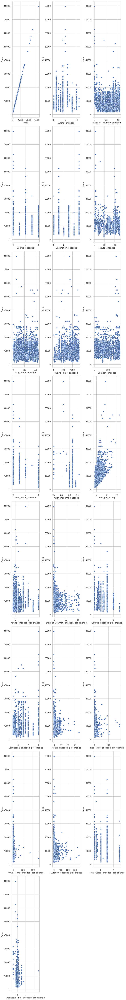

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
colist=data.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
plt.figure(figsize=(ncol*3, ncol*30))
for x in range(len(colist)):
    try:
        sns.set_theme(style='whitegrid')
        plt.subplot(nrows, ncol, x+1)
        sns.scatterplot(colist[x], y='Price', data=data)
        plt.tight_layout()
    except ValueError:
        continue

# It can be visualized from above scatter plots against outcome vector that the distribuution is mostly unevenly distributed for most of the columns. For example,
## Additional Info Encoded
## Route Encoded
## Destination Encoded... Many More...

# Anomalies Detected
## Highest price is 79512 received on 1/3/2019.
## In flight meal, business class and red eye flight were some of the prominent  benefits availed by passengers.
## Most significant price pct change is 4.5.
## Highest price is observed for Business Class flight with 1 stop by Jet Airways for route ( BLR → BOM → DEL)


# Q&A Answered
## What is the range of route encoded: 0 to 127.
## What is the range of airline encoded: 0 to 11.
## What is the range of price percentage change: 0 to 10.
## What is the range of total stops encoded: 0 to 4.

# Correlation Analysis

In [34]:
data.corr()

,Price,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,...,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
Price,1.000000,-0.039520,-0.036942,0.015998,-0.071112,0.164099,0.002949,0.027377,-0.144270,-0.571208,...,-0.011106,-0.002058,0.005504,-0.052114,0.052040,0.004169,-0.003860,-0.023226,-0.227740,-0.123116
Airline_encoded,-0.039520,1.000000,0.022251,-0.013401,0.018479,0.025072,-0.039439,-0.015733,0.027917,0.036000,...,0.522184,0.009169,0.005531,0.006911,0.014970,-0.011566,-0.012344,0.002025,0.017041,0.068966
Date_of_Journey_encoded,-0.036942,0.022251,1.000000,0.167549,-0.273357,0.275213,-0.007836,-0.012507,-0.001168,-0.044093,...,0.010947,0.293255,0.085119,-0.172499,0.075394,-0.009950,-0.003945,0.002272,-0.017213,0.024102
Source_encoded,0.015998,-0.013401,0.167549,1.000000,-0.592574,0.403390,0.055191,0.020844,-0.192009,-0.225605,...,-0.011493,0.063614,0.586342,-0.392421,0.113605,0.004709,0.005489,-0.019027,-0.091575,0.004385
Destination_encoded,-0.071112,0.018479,-0.273357,-0.592574,1.000000,-0.461177,-0.063608,-0.036830,0.022037,0.337877,...,0.013190,-0.089025,-0.337293,0.669912,-0.128186,-0.004197,-0.010831,0.003510,0.123044,0.009753
Route_encoded,0.164099,0.025072,0.275213,0.403390,-0.461177,1.000000,-0.082068,0.010539,-0.062106,-0.437747,...,0.021685,0.086041,0.227957,-0.306445,0.252809,-0.028915,-0.002603,0.001211,-0.165389,0.017769
Dep_Time_encoded,0.002949,-0.039439,-0.007836,0.055191,-0.063608,-0.082068,1.000000,-0.023294,0.041619,0.044659,...,-0.032125,0.001757,0.044822,-0.043445,-0.023189,0.210232,0.012358,-0.005086,0.030195,-0.033804
Arrival_Time_encoded,0.027377,-0.015733,-0.012507,0.020844,-0.036830,0.010539,-0.023294,1.000000,0.027746,-0.097165,...,-0.005545,-0.007094,0.009907,-0.027261,-0.006890,-0.011092,0.047569,0.011006,-0.037792,-0.008802
Duration_encoded,-0.144270,0.027917,-0.001168,-0.192009,0.022037,-0.062106,0.041619,0.027746,1.000000,0.175197,...,0.013439,0.003428,-0.111454,0.011777,-0.012370,0.013025,0.012535,0.141739,0.074967,0.057034
Total_Stops_encoded,-0.571208,0.036000,-0.044093,-0.225605,0.337877,-0.437747,0.044659,-0.097165,0.175197,1.000000,...,0.015033,-0.025384,-0.130319,0.233284,-0.120795,0.012466,-0.003786,0.024098,0.400126,0.157197


# The above table represents correlation among dataset. There seems some multicollinearity due to presence of destination encoded and source encoded; that show strong negative correlation between each other. Other than these columns, original columns and percentage transformation columns show multicoliinearity between each. The best way to find better version of the two to predict price is ANOVA Test and correlation with label. There seems modest collinearity among all other features. We will do further eda before arriving at a conclusion to delete these columns.

In [38]:
import cufflinks as cf
cf.set_config_file(offline=True)
pd.DataFrame((data.corr()['Price'])).iplot(title='Correlation Of Variables With Label')

# The above iplot represents correlation of features with label. Correlation of features with labe is of high relevance. The stronger the relationship of label with axis, the more accurate the prediction. In the above line graph:

## 1. Ignoring price pct change, highest correlation with label is observed to be -57.12%, that is shared with Total Stops Encoded. Minimum correlation is -0.21%, shared with Date_of_Journey_encoded_pct_change.

## 2. Weak Positive Relationship Is Found With Following Features:

    Dep_Time_encoded                      0.002949

    Dep_Time_encoded_pct_change           0.004169

    Source_encoded_pct_change             0.005504

    Source_encoded                        0.015998

    Arrival_Time_encoded                  0.027377

    Route_encoded_pct_change              0.052040

    Route_encoded                         0.164099


## 3. Weak Negative Relationship Is Found With Following Features:

    Total_Stops_encoded                  -0.571208

    Total_Stops_encoded_pct_change       -0.227740

    Additional_Info_encoded              -0.191652

    Duration_encoded                     -0.144270

    Additional_Info_encoded_pct_change   -0.123116

    Destination_encoded                  -0.071112

    Destination_encoded_pct_change       -0.052114

    Airline_encoded                      -0.039520

    Date_of_Journey_encoded              -0.036942

    Duration_encoded_pct_change          -0.023226

    Airline_encoded_pct_change           -0.011106

    Arrival_Time_encoded_pct_change      -0.003860

    Date_of_Journey_encoded_pct_change   -0.002058

## 4. Correlation Of Label with itself is of no relevance

# Mathematical Notation:¶
## Correlation (X, Y) = (Covariance Of X and Covariance Of Y)/(Std Of X and Std Of Y)

<AxesSubplot:>

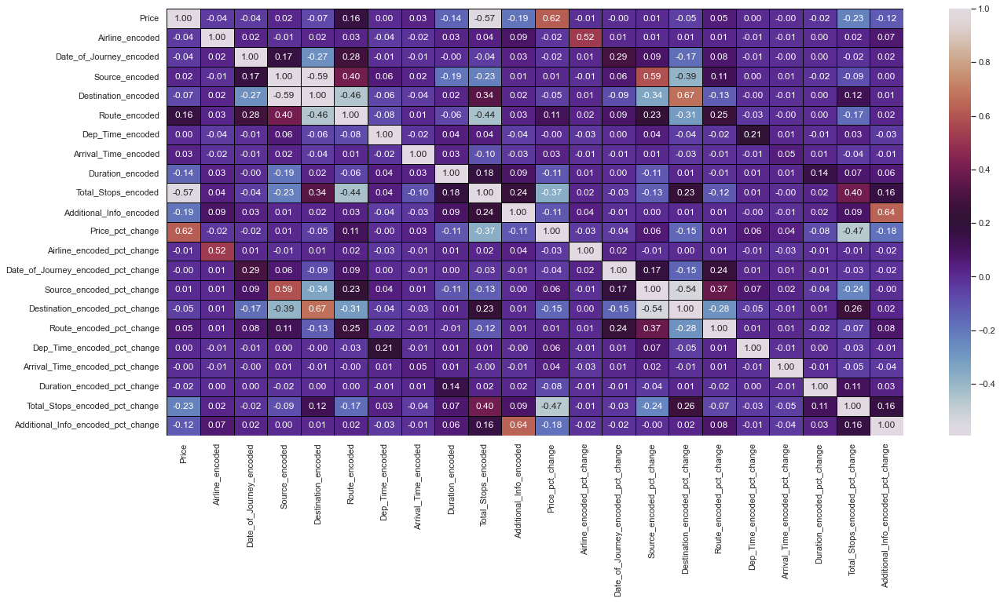

In [46]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(21,10))
sns.heatmap(data.corr(), annot=True, linewidths=0.5, linecolor='black', fmt='.2f', cmap='twilight')

In [47]:
data.corr()['Price'][data.corr()['Price']>0].index

Index(['Price', 'Source_encoded', 'Route_encoded', 'Dep_Time_encoded',
       'Arrival_Time_encoded', 'Price_pct_change', 'Source_encoded_pct_change',
       'Route_encoded_pct_change', 'Dep_Time_encoded_pct_change'],
      dtype='object')

# Verbal Translation Of Above Graph:
## 1. Label has weak positive relationship with these features:

# ['Price', 'Source_encoded', 'Route_encoded', 'Dep_Time_encoded',
#       'Arrival_Time_encoded', 'Price_pct_change', 'Source_encoded_pct_change',
#       'Route_encoded_pct_change', 'Dep_Time_encoded_pct_change']

## 2. Label has weak negative to strong negative relationship with these features in this heatmap:

# ['Airline_encoded', 'Date_of_Journey_encoded', 'Destination_encoded',
#       'Duration_encoded', 'Total_Stops_encoded', 'Additional_Info_encoded',
#       'Airline_encoded_pct_change', 'Date_of_Journey_encoded_pct_change',
#       'Destination_encoded_pct_change', 'Arrival_Time_encoded_pct_change',
#       'Duration_encoded_pct_change', 'Total_Stops_encoded_pct_change',
#       'Additional_Info_encoded_pct_change']


## 3. Strong Multicollinearity is detected among 2 features:

    destination encoded

    source encoded

## 4. Multicollinearity seems to be moderate among all other data points.

## Q&A Answered

        1. Most useful feature is: Total Stops Encoded.

        2. Features that can cause bias are: Destination Encoded And Source Encoded.

        3. Explanatory Power of all variable: Weak to Moderate (due to weak and moderate correlation with label).

# Data Handling Conclusion Of Correlation

# Overall moderately weak correlation among dataset. There seems some multicollinearity due to presence of Destination Encoded and Source Encoded; that show strong correlation between each other. Other than these columns there seems weak correlation. We will do further eda before arriving at a conclusion to delete these columns.

## The most useful feature is Total Stops Encoded, apart from this, there seems modest correlation of features with label.

## As a conclusion, we will do further cause and effect analysis based on skewness and distribution plots to conclude if we want to remove multicollinarity pairs:

    i. Destination Encoded And Source Encoded

# Dataset Information Table

In [48]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 22 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Price                               10683 non-null  int64  
 1   Airline_encoded                     10683 non-null  float64
 2   Date_of_Journey_encoded             10683 non-null  float64
 3   Source_encoded                      10683 non-null  float64
 4   Destination_encoded                 10683 non-null  float64
 5   Route_encoded                       10683 non-null  float64
 6   Dep_Time_encoded                    10683 non-null  float64
 7   Arrival_Time_encoded                10683 non-null  float64
 8   Duration_encoded                    10683 non-null  float64
 9   Total_Stops_encoded                 10683 non-null  float64
 10  Additional_Info_encoded             10683 non-null  float64
 11  Price_pct_change                    10683

# The above table reprents information dataset:
    
i. Columns

ii. Count Of Non Null Data Points

iii. Values data type for each columns

iv. Count of data types in iii.

v. Memory Usage

It can be deduced that the dataset has 10683 rows and each column has no missing value. The datatypes used are float64 and int64. There 21 float64 columns, 1 int64 column. Memory usage is 1.8 MB.

# Names Of All The Columns

In [49]:
data.select_dtypes(include = [np.number]).columns

Index(['Price', 'Airline_encoded', 'Date_of_Journey_encoded', 'Source_encoded',
       'Destination_encoded', 'Route_encoded', 'Dep_Time_encoded',
       'Arrival_Time_encoded', 'Duration_encoded', 'Total_Stops_encoded',
       'Additional_Info_encoded', 'Price_pct_change',
       'Airline_encoded_pct_change', 'Date_of_Journey_encoded_pct_change',
       'Source_encoded_pct_change', 'Destination_encoded_pct_change',
       'Route_encoded_pct_change', 'Dep_Time_encoded_pct_change',
       'Arrival_Time_encoded_pct_change', 'Duration_encoded_pct_change',
       'Total_Stops_encoded_pct_change', 'Additional_Info_encoded_pct_change'],
      dtype='object')

# The above code cell highlights all numeric columns, that will be used to derive following graphs.

# Box Plot To Detect Outliers

In [51]:
import plotly.express as px
colist=data.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
for x in colist:
    try:
        fig = px.box(data, x = x, y='Price')
        fig.show()
    except ValueError:
        print('{0} vales out of range, try skewness function to detect outliers'.format(x))
        continue

# Verbal Translation Of Above Graph
# 1. The data has many outliers.
# 2.  To name a few are:

    Airline Encoded

    Date Of Journey Encoded

    Source Encoded

    Destination Encoded

    Route Encoded

    Dep Time Encoded

    Duration Encoded

    Additional Info Encoded

    Source Encoded Pct Change

    Destination Encoded Pct Change

    Route Encoded Pct Change

    Total Stops Encoded Pct Change

# Data Handling Conclusion For Outliers

# By studying box plots and correlation analysis, we have found that outliers are present in all the columns, hence, removing outliers by data points. We will do further eda with vif, dist plots and descriptive statistics to finally select a set of features.

# Descriptive Statistics

In [52]:
description=data.describe()
description

,Price,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,...,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
count,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,...,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000
mean,9087.064121,3.965927,23.735093,1.952261,1.436113,74.824207,107.980717,869.828419,194.069269,1.458205,...,0.485816,0.750523,0.102320,0.305106,1.052223,0.948821,1.047133,2.479568,0.382110,0.006839
std,4611.359167,2.352155,12.337763,1.177221,1.474782,36.729696,61.085563,331.509504,108.620556,1.806241,...,1.563345,3.139317,0.725492,1.162313,3.875946,5.281847,17.354186,14.060744,1.041668,0.138719
min,1759.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,5277.000000,3.000000,14.000000,2.000000,0.000000,48.000000,55.000000,603.000000,106.000000,0.000000,...,-0.500000,-0.449138,-0.333333,-0.666667,-0.384615,-0.490488,-0.313888,-0.485042,-1.000000,0.000000
50%,8372.000000,4.000000,24.000000,2.000000,1.000000,73.000000,96.000000,937.000000,233.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
75%,12373.000000,4.000000,35.000000,3.000000,2.000000,104.000000,164.000000,1141.000000,280.000000,4.000000,...,1.000000,0.824808,1.000000,1.000000,0.625000,0.956755,0.453069,0.950000,1.000000,0.000000
max,79512.000000,11.000000,43.000000,4.000000,5.000000,127.000000,221.000000,1342.000000,367.000000,4.000000,...,9.000000,42.000000,3.000000,4.000000,89.000000,183.000000,1258.000000,355.000000,3.000000,5.000000


In [53]:
lst=description.columns.to_list()
print(lst)

['Price', 'Airline_encoded', 'Date_of_Journey_encoded', 'Source_encoded', 'Destination_encoded', 'Route_encoded', 'Dep_Time_encoded', 'Arrival_Time_encoded', 'Duration_encoded', 'Total_Stops_encoded', 'Additional_Info_encoded', 'Price_pct_change', 'Airline_encoded_pct_change', 'Date_of_Journey_encoded_pct_change', 'Source_encoded_pct_change', 'Destination_encoded_pct_change', 'Route_encoded_pct_change', 'Dep_Time_encoded_pct_change', 'Arrival_Time_encoded_pct_change', 'Duration_encoded_pct_change', 'Total_Stops_encoded_pct_change', 'Additional_Info_encoded_pct_change']


In [54]:
lst1=[]
for x in range(len(lst)):
    lst1.append([description.iloc[6,x]-description.iloc[5,x]])
len(lst1), print(lst1)

[[4001.0], [0.0], [11.0], [1.0], [1.0], [31.0], [68.0], [204.0], [47.0], [4.0], [0.0], [0.6725076401445809], [1.0], [0.8248081841432224], [1.0], [1.0], [0.625], [0.9567554932211314], [0.45306852409638554], [0.95], [0.0], [0.0]]


(22, None)

In [55]:
lst1_frame=pd.DataFrame(data=lst1, index=lst, columns=['IQR'])
lst1_frame=lst1_frame.T
lst1_frame

,Price,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,...,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
IQR,4001.0,0.0,11.0,1.0,1.0,31.0,68.0,204.0,47.0,4.0,...,1.0,0.824808,1.0,1.0,0.625,0.956755,0.453069,0.95,0.0,0.0


In [56]:
lst3=[]
for x in range(len(lst)):
    lst3.append([description.iloc[7,x]-description.iloc[3,x]])
len(lst3), print(lst3)

[[77753.0], [11.0], [43.0], [4.0], [5.0], [127.0], [221.0], [1342.0], [367.0], [4.0], [8.0], [12.442779919256095], [10.0], [43.0], [4.0], [5.0], [90.0], [184.0], [1259.0], [356.0], [4.0], [6.0]]


(22, None)

In [57]:
lst3_frame=pd.DataFrame(data=lst3, index=lst, columns=['Range'])
lst3_frame=lst3_frame.T
lst3_frame

,Price,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,...,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
Range,77753.0,11.0,43.0,4.0,5.0,127.0,221.0,1342.0,367.0,4.0,...,10.0,43.0,4.0,5.0,90.0,184.0,1259.0,356.0,4.0,6.0


In [59]:
lst5=pd.DataFrame(data=data.skew().to_list(), index=lst, columns=['Skewness'])
lst5=lst5.T
lst6=pd.DataFrame(data=data.kurtosis().to_list(), index=lst, columns=['Kurtosis'])
lst6=lst6.T
lst5, lst6

(             Price  Airline_encoded  Date_of_Journey_encoded  Source_encoded  \
 Skewness  1.812552         0.731095                -0.070888       -0.424054   
 
           Destination_encoded  Route_encoded  Dep_Time_encoded  \
 Skewness             1.244169      -0.502015          0.195055   
 
           Arrival_Time_encoded  Duration_encoded  Total_Stops_encoded  ...  \
 Skewness              -0.60653         -0.213427             0.631625  ...   
 
           Airline_encoded_pct_change  Date_of_Journey_encoded_pct_change  \
 Skewness                    2.530128                            7.398956   
 
           Source_encoded_pct_change  Destination_encoded_pct_change  \
 Skewness                   0.184387                        1.149762   
 
           Route_encoded_pct_change  Dep_Time_encoded_pct_change  \
 Skewness                   6.50822                    18.474233   
 
           Arrival_Time_encoded_pct_change  Duration_encoded_pct_change  \
 Skewness                

# Outcome Table Of Descriptive Statistics

In [60]:
description1=pd.concat([description, lst1_frame, lst3_frame, lst5, lst6])
description1

,Price,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,...,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
count,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,...,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000
mean,9087.064121,3.965927,23.735093,1.952261,1.436113,74.824207,107.980717,869.828419,194.069269,1.458205,...,0.485816,0.750523,0.102320,0.305106,1.052223,0.948821,1.047133,2.479568,0.382110,0.006839
std,4611.359167,2.352155,12.337763,1.177221,1.474782,36.729696,61.085563,331.509504,108.620556,1.806241,...,1.563345,3.139317,0.725492,1.162313,3.875946,5.281847,17.354186,14.060744,1.041668,0.138719
min,1759.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,5277.000000,3.000000,14.000000,2.000000,0.000000,48.000000,55.000000,603.000000,106.000000,0.000000,...,-0.500000,-0.449138,-0.333333,-0.666667,-0.384615,-0.490488,-0.313888,-0.485042,-1.000000,0.000000
50%,8372.000000,4.000000,24.000000,2.000000,1.000000,73.000000,96.000000,937.000000,233.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
75%,12373.000000,4.000000,35.000000,3.000000,2.000000,104.000000,164.000000,1141.000000,280.000000,4.000000,...,1.000000,0.824808,1.000000,1.000000,0.625000,0.956755,0.453069,0.950000,1.000000,0.000000
max,79512.000000,11.000000,43.000000,4.000000,5.000000,127.000000,221.000000,1342.000000,367.000000,4.000000,...,9.000000,42.000000,3.000000,4.000000,89.000000,183.000000,1258.000000,355.000000,3.000000,5.000000
IQR,4001.000000,0.000000,11.000000,1.000000,1.000000,31.000000,68.000000,204.000000,47.000000,4.000000,...,1.000000,0.824808,1.000000,1.000000,0.625000,0.956755,0.453069,0.950000,0.000000,0.000000
Range,77753.000000,11.000000,43.000000,4.000000,5.000000,127.000000,221.000000,1342.000000,367.000000,4.000000,...,10.000000,43.000000,4.000000,5.000000,90.000000,184.000000,1259.000000,356.000000,4.000000,6.000000


# Graphical Representation Of Above Table

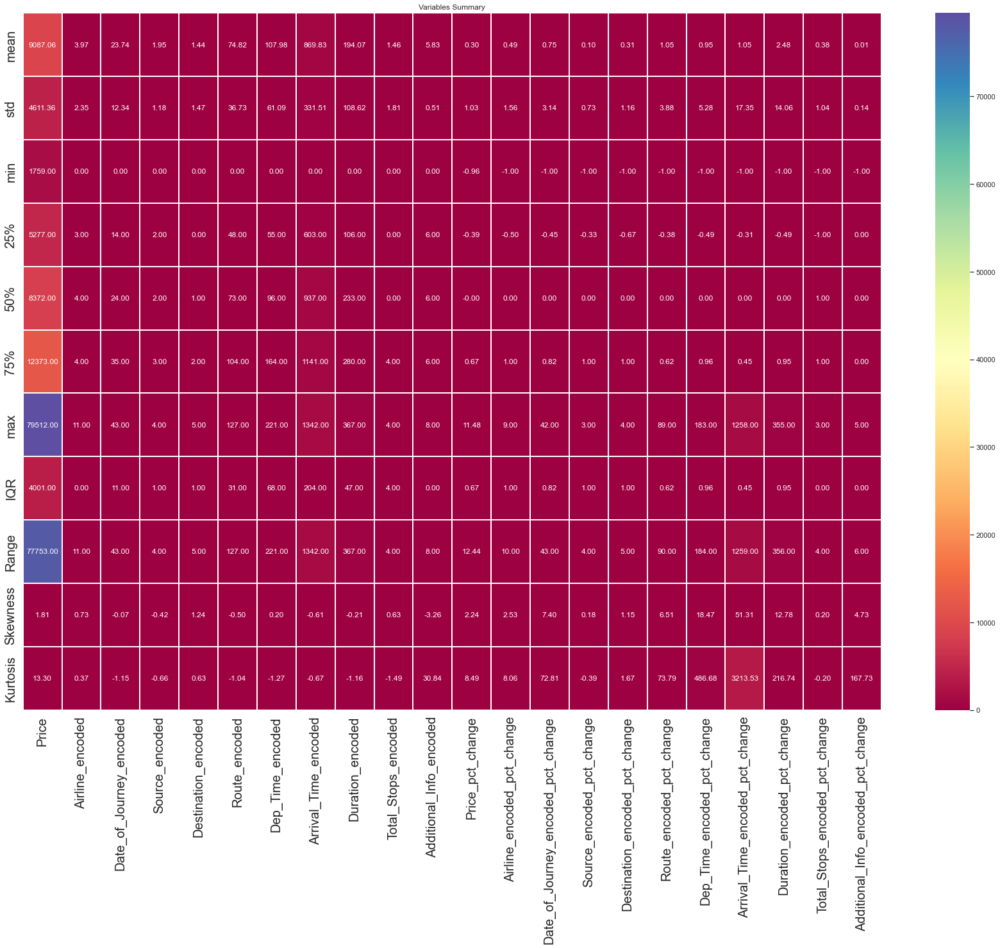

In [71]:
import numpy as np
plt.figure(figsize=(30,20))
sns.heatmap(np.round(description1[1:],2), linewidth=2, annot=True, fmt='.2f', square=False, cmap="Spectral")
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.title('Variables Summary')
plt.savefig('heatmap.png')
plt.show()

# Mathematical Notation:
1. Mean = sum of values/count of values                                                                                     
2. std = sqrt(((value - mean of distribution)**2 / number of values ))                                                                                        
3. 3 quartile are measures of variance, calculated to spot the placeholder value, it returns index of the produced value.
Step 1: sort the dataset                                                                                                   
Step2:                                                                                                                     
i) Lower Quartile (Q1: 25% distribution) = ((number of values+1)/4)th Term                                                 
ii) Middle Quartile (Q2: 50% distribution) = ((number of values +1)/2)th Term                                               
Also, know as median (central value).                                                                                       
iii) Upper Quartile (Q3: 75% distribution) = ¾(number of values + 1)th Term                                                 
iv) IQR = Upper Quartile - Lowe Quartile                                                                                   
4. Range = Maximum Value - Minimum Value                                                                                   
5. Skewness = (sumation(value - mean of distribution)**3)/((number of values - 1) * std**3)                                 
6. Kurtosis = number of values * ((sumation(value - mean of distribution)**4) / std**4)

# Verbal Translation Of Descriptive Table And Graphic
## 1. For values that are scaled upto 1, mean is mostly around 0 and standard deviation is comparatively low. Hence, making the data much more acceptable by algorithms to process it more accurately.

## 2. The entire dataset ranges from -1 till 79512.

## 3. Skewness is 0 and within +/- 0.65 for:
    ['Date_of_Journey_encoded', 'Source_encoded', 'Route_encoded',
           'Dep_Time_encoded', 'Arrival_Time_encoded', 'Duration_encoded',
           'Total_Stops_encoded', 'Source_encoded_pct_change',
           'Total_Stops_encoded_pct_change']

## 4. Acceptable skewness is +/- 0.65 and skewness for bell shaped curve should be 0.

## 5. Kutosis is upto 3 for most dataset, indicating platykurtic curves:

    ['Airline_encoded', 'Date_of_Journey_encoded', 'Source_encoded',
           'Destination_encoded', 'Route_encoded', 'Dep_Time_encoded',
           'Arrival_Time_encoded', 'Duration_encoded', 'Total_Stops_encoded',
           'Source_encoded_pct_change', 'Destination_encoded_pct_change',
           'Total_Stops_encoded_pct_change']

## 6. Kurtosis is greater than 3, indicating, leptokurtic curve:

    ['Price', 'Additional_Info_encoded', 'Price_pct_change',
           'Airline_encoded_pct_change', 'Date_of_Journey_encoded_pct_change',
           'Route_encoded_pct_change', 'Dep_Time_encoded_pct_change',
           'Arrival_Time_encoded_pct_change', 'Duration_encoded_pct_change',
           'Additional_Info_encoded_pct_change']
       

## 7. Kurtosis for bell shaped curve should be 3.

# Distribution Plots

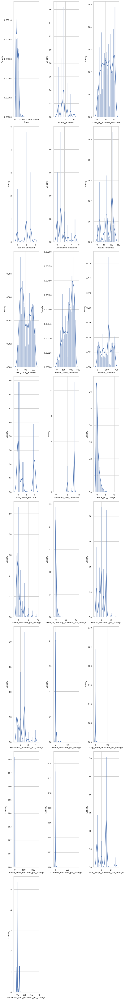

In [38]:
colist=data.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
plt.figure(figsize=(ncol*3, ncol*30))
for x in range(0,len(colist)):
    sns.set_theme(style='whitegrid')
    plt.subplot(nrows, ncol, x+1)
    sns.distplot(data[colist[x]])
    plt.tight_layout()

# Observations
## 1. Acceptable skewness is +/-0.65 and Right skewness for bell shaped curve is 0

## 2. Acceptable and Outliers Prone Left skewness is observed in:

        Date_of_Journey_encoded   -0.070888

        Source_encoded            -0.424054

        Route_encoded             -0.502015

        Arrival_Time_encoded      -0.606530

        Duration_encoded          -0.213427

        Additional_Info_encoded   -3.258820


## 3. Acceptable And Outliers Prone Right Skewness is observed in:
        
        Price                                  1.812552
        
        Airline_encoded                        0.731095
        
        Destination_encoded                    1.244169
        
        Dep_Time_encoded                       0.195055
        
        Total_Stops_encoded                    0.631625
        
        Price_pct_change                       2.241926
        
        Airline_encoded_pct_change             2.530128
        
        Date_of_Journey_encoded_pct_change     7.398956
        
        Source_encoded_pct_change              0.184387
        
        Destination_encoded_pct_change         1.149762
        
        Route_encoded_pct_change               6.508220
        
        Dep_Time_encoded_pct_change           18.474233
        
        Arrival_Time_encoded_pct_change       51.306256
        
        Duration_encoded_pct_change           12.775549
        
        Total_Stops_encoded_pct_change         0.204470
        
        Additional_Info_encoded_pct_change     4.726751

# Conclusion:
## Based On EDA done above in two parts, I will do ftest and pvalue test on these seemingly weak indicators based primarily on skewness, kurtosis and multicollinearity:

    Dep_Time_encoded_pct_change (Skewness & Kurtosis)

    Arrival_Time_encoded_pct_change (Skewness & Kurtosis)

    Duration_encoded_pct_change (Skewness & Kurtosis)

    Date_of_Journey_encoded_pct_change (Skewness & Kurtosis)
    
    Destination Encoded (Multicollinearity)
    
    Source Encoded (Multicollinearity)
      

# ANOVA Test On Selected Features
## Ftest score should be greater than 1 and p value should be less than 0.05, to determine to keep these features for further analysis

# Feature 1: Dep_Time_encoded_pct_change

In [86]:
from scipy.stats import f_oneway
f,p=f_oneway(data['Dep_Time_encoded_pct_change'], data['Price'])
f,p

(41475.463353311825, 0.0)

# Feature 2: Arrival_Time_encoded_pct_change

In [87]:
from scipy.stats import f_oneway
f,p=f_oneway(data['Dep_Time_encoded_pct_change'], data['Price'])
f,p

(41475.463353311825, 0.0)

# Feature 3: Duration_encoded_pct_change

In [88]:
from scipy.stats import f_oneway
f,p=f_oneway(data['Duration_encoded_pct_change'], data['Price'])
f,p

(41461.15862100788, 0.0)

# Feature 4: Date_of_Journey_encoded_pct_change

In [89]:
from scipy.stats import f_oneway
f,p=f_oneway(data['Date_of_Journey_encoded_pct_change'], data['Price'])
f,p

(41477.30891015438, 0.0)

# Feature 5: Destination Encoded

In [90]:
from scipy.stats import f_oneway
f,p=f_oneway(data['Date_of_Journey_encoded_pct_change'], data['Price'])
f,p

(41477.30891015438, 0.0)

# Feature 6: Source Encoded

In [91]:
from scipy.stats import f_oneway
f,p=f_oneway(data['Source_encoded'], data['Price'])
f,p

(41466.35473752089, 0.0)

# Error Removal And Data Handling

# Based on above analysis:
## 1. There are no outliers in the data.
## 2. Strong multicolliearity features are important for prediction because there f test and p value are acceptable. This means that the amount of multicollineaity is insignificant and removing the feature will not impact the model much.

# 3. Extereme leptokurtic and right skewed features are also relatively significant based on f test and p test.

# Hence, as a solution, feature scaling will do a better job in explaining the dependent variable than removing whole columns.

# Z Score: Outliers Treatment

In [92]:
import numpy as np
from scipy.stats import stats
from sklearn.preprocessing import StandardScaler
data[np.isinf(data)] = 0
scaled = StandardScaler()
data=data.fillna(method='ffill')
scaled.fit(data)
scaled_data = scaled.transform(data)
score=np.abs(stats.zscore(scaled_data))
score.shape

(10683, 22)

In [93]:
#threshold=(-3,3)
threshold=3
print(np.where(score>3))

(array([    9,    16,    21, ..., 10667, 10668, 10674], dtype=int64), array([16, 12, 15, ..., 15, 16, 15], dtype=int64))


# The above cell displays outlier values.

In [97]:
len(np.where(score>3)[0])

1648

# The above cell shows number of outliers.

In [96]:
data_new=data[(score<3).all(axis=1)]
data_new

,Price,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,...,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
0,3897,3.0,24.0,0.0,5.0,18.0,211.0,233.0,240.0,4.0,...,-0.666667,-0.750000,1.000000,-1.0,3.666667,-0.853081,2.888412,0.400000,-0.75,0.000000
1,7662,1.0,6.0,3.0,0.0,84.0,31.0,906.0,336.0,1.0,...,-0.666667,-0.750000,1.000000,-1.0,3.666667,-0.853081,2.888412,0.400000,-0.75,0.000000
2,13882,4.0,43.0,2.0,1.0,118.0,70.0,413.0,106.0,1.0,...,3.000000,6.166667,-0.333333,1.0,0.404762,1.258065,-0.544150,-0.684524,0.00,0.000000
3,6218,3.0,10.0,3.0,0.0,91.0,164.0,1324.0,311.0,0.0,...,-0.250000,-0.767442,0.500000,-1.0,-0.228814,1.342857,2.205811,1.933962,-1.00,0.000000
4,13302,3.0,0.0,0.0,5.0,29.0,149.0,1237.0,303.0,0.0,...,0.000000,-1.000000,-1.000000,1.0,-0.681319,-0.091463,-0.065710,-0.025723,1.00,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10678,4107,0.0,41.0,3.0,0.0,64.0,183.0,1259.0,236.0,4.0,...,-1.000000,0.863636,1.000000,-1.0,2.555556,4.718750,1.094842,-0.008403,0.00,-0.142857
10679,4145,1.0,29.0,3.0,0.0,64.0,193.0,1305.0,237.0,4.0,...,1.000000,-0.292683,0.000000,1.0,0.000000,0.054645,0.036537,0.004237,0.00,0.000000
10680,7229,4.0,29.0,0.0,2.0,18.0,58.0,824.0,280.0,4.0,...,3.000000,0.000000,-1.000000,1.0,-0.718750,-0.699482,-0.368582,0.181435,0.00,0.000000
10681,12648,10.0,0.0,0.0,5.0,18.0,92.0,938.0,238.0,4.0,...,1.500000,-1.000000,1.000000,1.5,0.000000,0.586207,0.138350,-0.150000,0.00,0.000000


# The above table shows the final dataframe after removing outliers, 1648 rows are removed and resultant dimension is 9241 rows * 22 columns

# Vectorization

# I have divided the datset into X and Y vectors by removing label and its transformation from features vector.
Label vector is Price.

In [98]:
x=data_new.drop(['Price', 'Price_pct_change'], axis=1)
x

,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
0,3.0,24.0,0.0,5.0,18.0,211.0,233.0,240.0,4.0,6.0,-0.666667,-0.750000,1.000000,-1.0,3.666667,-0.853081,2.888412,0.400000,-0.75,0.000000
1,1.0,6.0,3.0,0.0,84.0,31.0,906.0,336.0,1.0,6.0,-0.666667,-0.750000,1.000000,-1.0,3.666667,-0.853081,2.888412,0.400000,-0.75,0.000000
2,4.0,43.0,2.0,1.0,118.0,70.0,413.0,106.0,1.0,6.0,3.000000,6.166667,-0.333333,1.0,0.404762,1.258065,-0.544150,-0.684524,0.00,0.000000
3,3.0,10.0,3.0,0.0,91.0,164.0,1324.0,311.0,0.0,6.0,-0.250000,-0.767442,0.500000,-1.0,-0.228814,1.342857,2.205811,1.933962,-1.00,0.000000
4,3.0,0.0,0.0,5.0,29.0,149.0,1237.0,303.0,0.0,6.0,0.000000,-1.000000,-1.000000,1.0,-0.681319,-0.091463,-0.065710,-0.025723,1.00,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10678,0.0,41.0,3.0,0.0,64.0,183.0,1259.0,236.0,4.0,6.0,-1.000000,0.863636,1.000000,-1.0,2.555556,4.718750,1.094842,-0.008403,0.00,-0.142857
10679,1.0,29.0,3.0,0.0,64.0,193.0,1305.0,237.0,4.0,6.0,1.000000,-0.292683,0.000000,1.0,0.000000,0.054645,0.036537,0.004237,0.00,0.000000
10680,4.0,29.0,0.0,2.0,18.0,58.0,824.0,280.0,4.0,6.0,3.000000,0.000000,-1.000000,1.0,-0.718750,-0.699482,-0.368582,0.181435,0.00,0.000000
10681,10.0,0.0,0.0,5.0,18.0,92.0,938.0,238.0,4.0,6.0,1.500000,-1.000000,1.000000,1.5,0.000000,0.586207,0.138350,-0.150000,0.00,0.000000


# The above table displays samples of features vector.

In [99]:
y=data_new['Price']
y

0         3897
1         7662
2        13882
3         6218
4        13302
         ...  
10678     4107
10679     4145
10680     7229
10681    12648
10682    11753
Name: Price, Length: 9241, dtype: int64

# The above series displays samples of label series.

# Outliers Transformation With Power Transform

In [100]:
from sklearn.preprocessing import power_transform
x_array=power_transform(x, method='yeo-johnson')
x_frame=pd.DataFrame(x_array, columns=x.columns)
x_frame

,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
0,-0.274781,0.028944,-1.691343,1.938629,-1.635750,1.503785,-1.792535,0.466230,1.290151,0.308351,-1.163297,-1.495495,1.292788,-1.400289,1.644653,-1.638866,1.725280,0.381804,-1.087129,0.005315
1,-1.411841,-1.581238,0.873201,-1.355173,0.148518,-1.349430,0.043798,1.240586,0.348201,0.308351,-1.163297,-1.495495,1.292788,-1.400289,1.644653,-1.638866,1.725280,0.381804,-1.087129,0.005315
2,0.177472,1.493358,-0.101603,0.088628,1.221391,-0.509969,-1.381377,-0.736262,0.348201,0.308351,1.698165,2.131424,-0.629356,0.874860,0.440733,0.911299,-1.173030,-1.094359,-0.327174,0.005315
3,-0.274781,-1.188454,0.873201,-1.355173,0.363016,0.923356,1.489407,1.043759,-0.908281,0.308351,-0.358160,-1.542242,0.599845,-1.400289,-0.353809,0.948458,1.540928,1.034154,-1.347236,0.005315
4,-0.274781,-2.279851,-1.691343,1.938629,-1.379333,0.723934,1.173901,0.980116,-0.908281,0.308351,0.007050,-2.220357,-1.687080,0.874860,-1.364997,-0.118657,-0.053263,0.000247,0.630002,0.005315
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9236,-2.232631,1.345639,0.873201,-1.355173,-0.442948,1.165384,1.253006,0.432753,1.290151,0.308351,-1.987369,0.776028,1.292788,-1.400289,1.411873,1.754530,1.079098,0.019842,-0.327174,-1.389551
9237,-1.411841,0.429468,0.873201,-1.355173,-0.442948,1.288561,1.419895,0.441133,1.290151,0.308351,0.875290,-0.468222,-0.123820,0.874860,0.004672,0.065493,0.114063,0.033864,-0.327174,0.005315
9238,0.177472,0.429468,-1.691343,0.828608,-1.635750,-0.741037,-0.217072,0.795234,1.290151,0.308351,1.698165,-0.003538,-1.687080,0.874860,-1.467658,-1.253160,-0.694675,0.208730,-0.327174,0.005315
9239,2.215232,-2.279851,-1.691343,1.938629,-1.635750,-0.125172,0.147799,0.449506,1.290151,0.308351,1.145031,-2.220357,1.292788,1.324761,0.004672,0.538117,0.259217,-0.153492,-0.327174,0.005315


# The above table displays outliers transformed values as discussed above.

In [101]:
x_frame[np.isinf(x_frame)] = 0
x_frame[np.isnan(x_frame)]=0

# In the above cell, I have filled infinite and na values with 0, in case those arose during the process of transformation.

In [102]:
y.unique()

array([ 3897,  7662, 13882, ...,  9790, 12352, 12648], dtype=int64)

# MinMax Scaler Transformation And Variance Inflation Factor

In [103]:
import sklearn
from sklearn.preprocessing import MinMaxScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor
import warnings
warnings.filterwarnings('ignore')
scaler=MinMaxScaler([0,1])
X_scaled=scaler.fit_transform(x)
X_scaled_frame=pd.DataFrame(X_scaled, columns=x.columns)
X_scaled_frame

,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change
0,0.272727,0.558140,0.00,1.0,0.141732,0.954751,0.173621,0.653951,1.00,0.5,0.055556,0.022727,0.666667,0.000,0.348259,0.008361,0.072648,0.031111,0.0625,0.483871
1,0.090909,0.139535,0.75,0.0,0.661417,0.140271,0.675112,0.915531,0.25,0.5,0.055556,0.022727,0.666667,0.000,0.348259,0.008361,0.072648,0.031111,0.0625,0.483871
2,0.363636,1.000000,0.50,0.2,0.929134,0.316742,0.307750,0.288828,0.25,0.5,0.666667,0.651515,0.222222,0.500,0.104833,0.128508,0.008517,0.007011,0.2500,0.483871
3,0.272727,0.232558,0.75,0.0,0.716535,0.742081,0.986587,0.847411,0.00,0.5,0.125000,0.021142,0.500000,0.000,0.057551,0.133333,0.059895,0.065199,0.0000,0.483871
4,0.272727,0.000000,0.00,1.0,0.228346,0.674208,0.921759,0.825613,0.00,0.5,0.166667,0.000000,0.000000,0.500,0.023782,0.051705,0.017456,0.021651,0.5000,0.483871
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9236,0.000000,0.953488,0.75,0.0,0.503937,0.828054,0.938152,0.643052,1.00,0.5,0.000000,0.169421,0.666667,0.000,0.265340,0.325457,0.039139,0.022035,0.2500,0.299539
9237,0.090909,0.674419,0.75,0.0,0.503937,0.873303,0.972429,0.645777,1.00,0.5,0.333333,0.064302,0.333333,0.500,0.074627,0.060020,0.019366,0.022316,0.2500,0.483871
9238,0.363636,0.674419,0.00,0.4,0.141732,0.262443,0.614009,0.762943,1.00,0.5,0.666667,0.090909,0.000000,0.500,0.020989,0.017103,0.011797,0.026254,0.2500,0.483871
9239,0.909091,0.000000,0.00,1.0,0.141732,0.416290,0.698957,0.648501,1.00,0.5,0.416667,0.000000,0.666667,0.625,0.074627,0.090272,0.021268,0.018889,0.2500,0.483871


In [104]:
vif=pd.DataFrame()
vif['vif']=[variance_inflation_factor(X_scaled, w) for w in range(X_scaled.shape[1])]
vif['Features']=x.columns
vif

,vif,Features
0,5.037465,Airline_encoded
1,6.430205,Date_of_Journey_encoded
2,9.667413,Source_encoded
3,4.335287,Destination_encoded
4,9.196673,Route_encoded
5,4.872415,Dep_Time_encoded
6,7.177598,Arrival_Time_encoded
7,4.563241,Duration_encoded
8,3.151129,Total_Stops_encoded
9,9.249751,Additional_Info_encoded


In [105]:
X_scaled_frame=X_scaled_frame.drop(['Source_encoded', 'Route_encoded', 'Arrival_Time_encoded'], axis=1)
x=X_scaled_frame

In [106]:
X_scaled=np.array(x)

In [107]:
vif=pd.DataFrame()
vif['vif']=[variance_inflation_factor(X_scaled, w) for w in range(X_scaled.shape[1])]
vif['Features']=x.columns
vif

,vif,Features
0,5.021353,Airline_encoded
1,5.874019,Date_of_Journey_encoded
2,3.303458,Destination_encoded
3,4.806858,Dep_Time_encoded
4,4.322515,Duration_encoded
5,2.527172,Total_Stops_encoded
6,9.164298,Additional_Info_encoded
7,2.860093,Airline_encoded_pct_change
8,2.518985,Date_of_Journey_encoded_pct_change
9,4.528583,Source_encoded_pct_change


In [108]:
X_scaled_frame1=X_scaled_frame.drop(['Additional_Info_encoded_pct_change','Additional_Info_encoded'] , axis=1)
x=X_scaled_frame1

In [109]:
X_scaled=np.array(x)

In [110]:
vif=pd.DataFrame()
vif['vif']=[variance_inflation_factor(X_scaled, w) for w in range(X_scaled.shape[1])]
vif['Features']=x.columns
vif

,vif,Features
0,4.763716,Airline_encoded
1,5.577566,Date_of_Journey_encoded
2,3.285018,Destination_encoded
3,4.704876,Dep_Time_encoded
4,4.088228,Duration_encoded
5,2.417642,Total_Stops_encoded
6,2.849420,Airline_encoded_pct_change
7,2.515961,Date_of_Journey_encoded_pct_change
8,4.192464,Source_encoded_pct_change
9,4.643165,Destination_encoded_pct_change


# Now, all the features, seem to have lower multi collinearity, is below 6. Now, I will apply p values feature selection, to deciede which features to include.

# Data Handling Conclusion

# Concluding Points:
## As part of data handling, I have closely analyzed features with high outliers (by analyzing box plots, dist plots, variable plot and scatter plots).

## I have removed features with multicollinearity by analyzing correlation, correlation heatmaps and variance inflation factor.

## I have done ANOVA testing, wherever, applicable to weigh importance against bias.Hence, the model can be expected to be low variance and low bias model

# Feature Selection

In [111]:
from sklearn.feature_selection import f_classif, f_regression
from sklearn.feature_selection import SelectKBest, SelectPercentile
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from sklearn.feature_selection import VarianceThreshold

In [113]:
x.shape, y.shape

((9241, 15), (9241,))

In [112]:
Xf_train, Xf_test, Y_train, Y_test=train_test_split(x,y,test_size=0.30)

# In the above cell, I have checked final shape of each vector and splitted the data into 30% test and 70% train.

In [114]:
constant_filter=VarianceThreshold(threshold=0.01)
constant_filter.fit(Xf_train)
Xf_train_filter=constant_filter.transform(Xf_train)
Xf_test_filter=constant_filter.transform(Xf_test)

# In the above code, I have put the values in Variance Threshold Filter and transformed those. To ensure low variance, I have taken variance threshold of 0.01.

<AxesSubplot:>

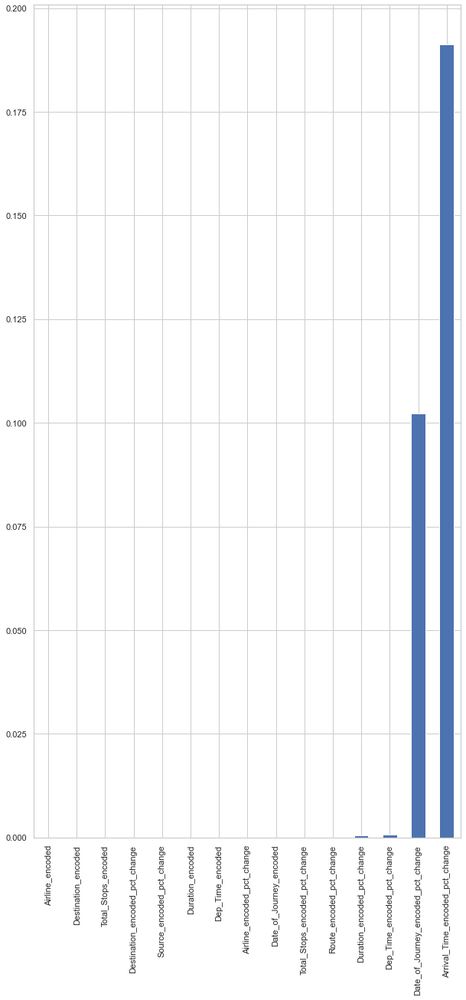

In [115]:
sel=f_classif(Xf_train, Y_train)
p_values=pd.Series(sel[1])
p_values.index=Xf_train.columns
p_values.sort_values(ascending=True, inplace=True)
p_values.plot.bar(figsize=(10,20))

# I have used these transformed values to generate pvalue of each feature (to explain label).

# Mathematical Notation

P Value = (sample proportion - Assumed population proportion in the null hypothesis)/(sqrt((Assumed population proportion in the null hypothesis * ( 1 - Assumed population proportion in the null hypothesis )) / n))

In [116]:
p_values=p_values[p_values<0.05]
p_values.index

Index(['Airline_encoded', 'Destination_encoded', 'Total_Stops_encoded',
       'Destination_encoded_pct_change', 'Source_encoded_pct_change',
       'Duration_encoded', 'Dep_Time_encoded', 'Airline_encoded_pct_change',
       'Date_of_Journey_encoded', 'Total_Stops_encoded_pct_change',
       'Route_encoded_pct_change', 'Duration_encoded_pct_change',
       'Dep_Time_encoded_pct_change'],
      dtype='object')

# P Values are an important component of feature selection, with significance level set to 0.05, Variance Threshold
    ensemble technique returns with 95% confidence, all the features that have maximum explanatory capacity
For the present dataset features with pvalues with less than 0.05 are:
['Airline_encoded', 'Destination_encoded', 'Total_Stops_encoded',
       'Destination_encoded_pct_change', 'Source_encoded_pct_change',
       'Duration_encoded', 'Dep_Time_encoded', 'Airline_encoded_pct_change',
       'Date_of_Journey_encoded', 'Total_Stops_encoded_pct_change',
       'Route_encoded_pct_change', 'Duration_encoded_pct_change',
       'Dep_Time_encoded_pct_change']

In [117]:
import numpy as np
x=x[['Airline_encoded', 'Destination_encoded', 'Total_Stops_encoded',
       'Destination_encoded_pct_change', 'Source_encoded_pct_change',
       'Duration_encoded', 'Dep_Time_encoded', 'Airline_encoded_pct_change',
       'Date_of_Journey_encoded', 'Total_Stops_encoded_pct_change',
       'Route_encoded_pct_change', 'Duration_encoded_pct_change',
       'Dep_Time_encoded_pct_change']]
x.sample()

,Airline_encoded,Destination_encoded,Total_Stops_encoded,Destination_encoded_pct_change,Source_encoded_pct_change,Duration_encoded,Dep_Time_encoded,Airline_encoded_pct_change,Date_of_Journey_encoded,Total_Stops_encoded_pct_change,Route_encoded_pct_change,Duration_encoded_pct_change,Dep_Time_encoded_pct_change
8805,0.363636,0.6,1.0,0.75,0.666667,0.3297,0.809955,0.166667,0.883721,1.0,0.0317,0.067222,0.391807


# The above table displays a sample of final x vector with features and values finally selected to be used for prediction

In [118]:
y.sample()

4465    10844
Name: Price, dtype: int64

# The above series displays a sample of label.

In [119]:
x.shape, y.shape

((9241, 13), (9241,))

# The above cell displays final shapes of x and y vectors

In [120]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3)

In [121]:
x_train.shape, y_train.shape

((6468, 13), (6468,))

# In the above two cells, I have divided final vectors with train test split technique, in which train data is 30% and test data is 70% to avoid overfitting issue.

# Git Test Data For Evaluation

# Out Of Sample DataSet Preparation

In [122]:
import numpy as np
from sklearn.preprocessing import OrdinalEncoder
encoder = OrdinalEncoder()
# transform data
result1 = encoder.fit_transform(test_data[test_data.select_dtypes(object).columns])
result1

array([[  4.,  39.,   2., ...,  10.,   0.,   5.],
       [  3.,  10.,   3., ..., 248.,   0.,   5.],
       [  4.,  22.,   2., ..., 148.,   0.,   3.],
       ...,
       [  4.,  36.,   2., ..., 278.,   0.,   5.],
       [  1.,  36.,   2., ...,  60.,   0.,   5.],
       [  6.,  15.,   2., ...,  49.,   0.,   5.]])

In [123]:
len(result1)

2671

In [124]:
len(test_data)

2671

In [125]:
encoded1=test_data.select_dtypes(include = [object]).columns
encoded1

Index(['Airline', 'Date_of_Journey', 'Source', 'Destination', 'Route',
       'Dep_Time', 'Arrival_Time', 'Duration', 'Total_Stops',
       'Additional_Info'],
      dtype='object')

In [126]:
encoded_data1=pd.DataFrame(data=result1, columns=encoded1+'_encoded')
encoded_data1

,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded
0,4.0,39.0,2.0,1.0,76.0,138.0,150.0,10.0,0.0,5.0
1,3.0,10.0,3.0,0.0,65.0,31.0,353.0,248.0,0.0,5.0
2,4.0,22.0,2.0,1.0,76.0,156.0,566.0,148.0,0.0,3.0
3,6.0,22.0,2.0,1.0,76.0,48.0,633.0,36.0,0.0,5.0
4,0.0,27.0,0.0,2.0,16.0,198.0,135.0,216.0,4.0,5.0
...,...,...,...,...,...,...,...,...,...,...
2666,1.0,39.0,3.0,0.0,51.0,170.0,617.0,150.0,0.0,5.0
2667,3.0,28.0,3.0,0.0,43.0,106.0,507.0,213.0,4.0,5.0
2668,4.0,36.0,2.0,1.0,76.0,183.0,151.0,278.0,0.0,5.0
2669,1.0,36.0,2.0,1.0,76.0,11.0,577.0,60.0,0.0,5.0


In [127]:
actual_y=pd.read_excel('C:/Users/Lenovo/Downloads/Flight_Ticket_Participant_Datasets-20190305T100527Z-001/Flight_Ticket_Participant_Datasets/Sample_submission.xlsx')
new_data1=pd.concat([test_data, encoded_data1], axis=1)
new_data1

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded
0,Jet Airways,6/06/2019,Delhi,Cochin,DEL → BOM → COK,17:30,04:25 07 Jun,10h 55m,1 stop,No info,4.0,39.0,2.0,1.0,76.0,138.0,150.0,10.0,0.0,5.0
1,IndiGo,12/05/2019,Kolkata,Banglore,CCU → MAA → BLR,06:20,10:20,4h,1 stop,No info,3.0,10.0,3.0,0.0,65.0,31.0,353.0,248.0,0.0,5.0
2,Jet Airways,21/05/2019,Delhi,Cochin,DEL → BOM → COK,19:15,19:00 22 May,23h 45m,1 stop,In-flight meal not included,4.0,22.0,2.0,1.0,76.0,156.0,566.0,148.0,0.0,3.0
3,Multiple carriers,21/05/2019,Delhi,Cochin,DEL → BOM → COK,08:00,21:00,13h,1 stop,No info,6.0,22.0,2.0,1.0,76.0,48.0,633.0,36.0,0.0,5.0
4,Air Asia,24/06/2019,Banglore,Delhi,BLR → DEL,23:55,02:45 25 Jun,2h 50m,non-stop,No info,0.0,27.0,0.0,2.0,16.0,198.0,135.0,216.0,4.0,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2666,Air India,6/06/2019,Kolkata,Banglore,CCU → DEL → BLR,20:30,20:25 07 Jun,23h 55m,1 stop,No info,1.0,39.0,3.0,0.0,51.0,170.0,617.0,150.0,0.0,5.0
2667,IndiGo,27/03/2019,Kolkata,Banglore,CCU → BLR,14:20,16:55,2h 35m,non-stop,No info,3.0,28.0,3.0,0.0,43.0,106.0,507.0,213.0,4.0,5.0
2668,Jet Airways,6/03/2019,Delhi,Cochin,DEL → BOM → COK,21:50,04:25 07 Mar,6h 35m,1 stop,No info,4.0,36.0,2.0,1.0,76.0,183.0,151.0,278.0,0.0,5.0
2669,Air India,6/03/2019,Delhi,Cochin,DEL → BOM → COK,04:00,19:15,15h 15m,1 stop,No info,1.0,36.0,2.0,1.0,76.0,11.0,577.0,60.0,0.0,5.0


In [128]:
new_data1=pd.concat([new_data1, actual_y], axis=1)
new_data1

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,...,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded,Price
0,Jet Airways,6/06/2019,Delhi,Cochin,DEL → BOM → COK,17:30,04:25 07 Jun,10h 55m,1 stop,No info,...,39.0,2.0,1.0,76.0,138.0,150.0,10.0,0.0,5.0,15998
1,IndiGo,12/05/2019,Kolkata,Banglore,CCU → MAA → BLR,06:20,10:20,4h,1 stop,No info,...,10.0,3.0,0.0,65.0,31.0,353.0,248.0,0.0,5.0,16612
2,Jet Airways,21/05/2019,Delhi,Cochin,DEL → BOM → COK,19:15,19:00 22 May,23h 45m,1 stop,In-flight meal not included,...,22.0,2.0,1.0,76.0,156.0,566.0,148.0,0.0,3.0,25572
3,Multiple carriers,21/05/2019,Delhi,Cochin,DEL → BOM → COK,08:00,21:00,13h,1 stop,No info,...,22.0,2.0,1.0,76.0,48.0,633.0,36.0,0.0,5.0,25778
4,Air Asia,24/06/2019,Banglore,Delhi,BLR → DEL,23:55,02:45 25 Jun,2h 50m,non-stop,No info,...,27.0,0.0,2.0,16.0,198.0,135.0,216.0,4.0,5.0,16934
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2666,Air India,6/06/2019,Kolkata,Banglore,CCU → DEL → BLR,20:30,20:25 07 Jun,23h 55m,1 stop,No info,...,39.0,3.0,0.0,51.0,170.0,617.0,150.0,0.0,5.0,14046
2667,IndiGo,27/03/2019,Kolkata,Banglore,CCU → BLR,14:20,16:55,2h 35m,non-stop,No info,...,28.0,3.0,0.0,43.0,106.0,507.0,213.0,4.0,5.0,14086
2668,Jet Airways,6/03/2019,Delhi,Cochin,DEL → BOM → COK,21:50,04:25 07 Mar,6h 35m,1 stop,No info,...,36.0,2.0,1.0,76.0,183.0,151.0,278.0,0.0,5.0,22720
2669,Air India,6/03/2019,Delhi,Cochin,DEL → BOM → COK,04:00,19:15,15h 15m,1 stop,No info,...,36.0,2.0,1.0,76.0,11.0,577.0,60.0,0.0,5.0,23544


In [129]:
new_data1=new_data1.drop(encoded, axis=1)
new_data1

,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded,Price
0,4.0,39.0,2.0,1.0,76.0,138.0,150.0,10.0,0.0,5.0,15998
1,3.0,10.0,3.0,0.0,65.0,31.0,353.0,248.0,0.0,5.0,16612
2,4.0,22.0,2.0,1.0,76.0,156.0,566.0,148.0,0.0,3.0,25572
3,6.0,22.0,2.0,1.0,76.0,48.0,633.0,36.0,0.0,5.0,25778
4,0.0,27.0,0.0,2.0,16.0,198.0,135.0,216.0,4.0,5.0,16934
...,...,...,...,...,...,...,...,...,...,...,...
2666,1.0,39.0,3.0,0.0,51.0,170.0,617.0,150.0,0.0,5.0,14046
2667,3.0,28.0,3.0,0.0,43.0,106.0,507.0,213.0,4.0,5.0,14086
2668,4.0,36.0,2.0,1.0,76.0,183.0,151.0,278.0,0.0,5.0,22720
2669,1.0,36.0,2.0,1.0,76.0,11.0,577.0,60.0,0.0,5.0,23544


In [130]:
pct_change=new_data1.pct_change()
pct_change.columns=new_data1.columns+'_pct_change'
pct_change

,Airline_encoded_pct_change,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change,Price_pct_change
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.250000,-0.743590,0.500000,-1.0,-0.144737,-0.775362,1.353333,23.800000,NaN,0.000000,0.038380
2,0.333333,1.200000,-0.333333,inf,0.169231,4.032258,0.603399,-0.403226,NaN,-0.400000,0.539369
3,0.500000,0.000000,0.000000,0.0,0.000000,-0.692308,0.118375,-0.756757,NaN,0.666667,0.008056
4,-1.000000,0.227273,-1.000000,1.0,-0.789474,3.125000,-0.786730,5.000000,inf,0.000000,-0.343083
...,...,...,...,...,...,...,...,...,...,...,...
2666,-0.875000,0.695652,-0.250000,-1.0,0.545455,-0.109948,15.675676,0.351351,-1.0,0.250000,0.134480
2667,2.000000,-0.282051,0.000000,NaN,-0.156863,-0.376471,-0.178282,0.420000,inf,0.000000,0.002848
2668,0.333333,0.285714,-0.333333,inf,0.767442,0.726415,-0.702170,0.305164,-1.0,0.000000,0.612949
2669,-0.750000,0.000000,0.000000,0.0,0.000000,-0.939891,2.821192,-0.784173,NaN,0.000000,0.036268


In [131]:
test_data=pd.concat([new_data1, pct_change], axis=1)
test_data=test_data.fillna(method='bfill')
test_data=test_data.fillna(method='ffill')
test_data=test_data.replace([np.inf, -np.inf],1)
test_data

,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded,...,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change,Price_pct_change
0,4.0,39.0,2.0,1.0,76.0,138.0,150.0,10.0,0.0,5.0,...,-0.743590,0.500000,-1.0,-0.144737,-0.775362,1.353333,23.800000,1.0,0.000000,0.038380
1,3.0,10.0,3.0,0.0,65.0,31.0,353.0,248.0,0.0,5.0,...,-0.743590,0.500000,-1.0,-0.144737,-0.775362,1.353333,23.800000,1.0,0.000000,0.038380
2,4.0,22.0,2.0,1.0,76.0,156.0,566.0,148.0,0.0,3.0,...,1.200000,-0.333333,1.0,0.169231,4.032258,0.603399,-0.403226,1.0,-0.400000,0.539369
3,6.0,22.0,2.0,1.0,76.0,48.0,633.0,36.0,0.0,5.0,...,0.000000,0.000000,0.0,0.000000,-0.692308,0.118375,-0.756757,1.0,0.666667,0.008056
4,0.0,27.0,0.0,2.0,16.0,198.0,135.0,216.0,4.0,5.0,...,0.227273,-1.000000,1.0,-0.789474,3.125000,-0.786730,5.000000,1.0,0.000000,-0.343083
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2666,1.0,39.0,3.0,0.0,51.0,170.0,617.0,150.0,0.0,5.0,...,0.695652,-0.250000,-1.0,0.545455,-0.109948,15.675676,0.351351,-1.0,0.250000,0.134480
2667,3.0,28.0,3.0,0.0,43.0,106.0,507.0,213.0,4.0,5.0,...,-0.282051,0.000000,1.0,-0.156863,-0.376471,-0.178282,0.420000,1.0,0.000000,0.002848
2668,4.0,36.0,2.0,1.0,76.0,183.0,151.0,278.0,0.0,5.0,...,0.285714,-0.333333,1.0,0.767442,0.726415,-0.702170,0.305164,-1.0,0.000000,0.612949
2669,1.0,36.0,2.0,1.0,76.0,11.0,577.0,60.0,0.0,5.0,...,0.000000,0.000000,0.0,0.000000,-0.939891,2.821192,-0.784173,-1.0,0.000000,0.036268


In [132]:
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2671 entries, 0 to 2670
Data columns (total 22 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Airline_encoded                     2671 non-null   float64
 1   Date_of_Journey_encoded             2671 non-null   float64
 2   Source_encoded                      2671 non-null   float64
 3   Destination_encoded                 2671 non-null   float64
 4   Route_encoded                       2671 non-null   float64
 5   Dep_Time_encoded                    2671 non-null   float64
 6   Arrival_Time_encoded                2671 non-null   float64
 7   Duration_encoded                    2671 non-null   float64
 8   Total_Stops_encoded                 2671 non-null   float64
 9   Additional_Info_encoded             2671 non-null   float64
 10  Price                               2671 non-null   int64  
 11  Airline_encoded_pct_change          2671 no

In [133]:
import numpy as np
from scipy.stats import stats
from sklearn.preprocessing import StandardScaler
test_data[np.isinf(test_data)] = 0
scaled = StandardScaler()
test_data=test_data.fillna(method='ffill')
scaled.fit(test_data)
scaled_test_data = scaled.transform(test_data)
score=np.abs(stats.zscore(scaled_test_data))
score.shape

(2671, 22)

In [134]:
#threshold=(-3,3)
threshold=3
print(np.where(score>3))

(array([   6,   13,   13,   14,   15,   16,   16,   19,   20,   23,   38,
         54,   57,   58,   63,   64,   78,  100,  108,  108,  113,  116,
        117,  117,  137,  143,  156,  167,  172,  173,  174,  175,  184,
        184,  185,  186,  201,  203,  222,  233,  235,  236,  241,  242,
        243,  247,  262,  266,  272,  280,  281,  281,  283,  285,  291,
        292,  293,  304,  305,  316,  319,  323,  324,  325,  325,  332,
        339,  344,  344,  356,  358,  371,  383,  390,  398,  411,  418,
        423,  424,  424,  429,  431,  470,  470,  474,  474,  476,  498,
        505,  505,  507,  507,  510,  511,  512,  522,  523,  546,  560,
        569,  573,  576,  579,  585,  586,  589,  594,  606,  624,  625,
        633,  638,  638,  639,  642,  643,  649,  650,  663,  663,  664,
        671,  679,  680,  688,  689,  697,  708,  709,  710,  710,  720,
        721,  735,  735,  747,  752,  760,  771,  772,  773,  775,  778,
        782,  807,  813,  814,  830,  830,  849,  

In [135]:
data_new=test_data[(score<3).all(axis=1)]
data_new

,Airline_encoded,Date_of_Journey_encoded,Source_encoded,Destination_encoded,Route_encoded,Dep_Time_encoded,Arrival_Time_encoded,Duration_encoded,Total_Stops_encoded,Additional_Info_encoded,...,Date_of_Journey_encoded_pct_change,Source_encoded_pct_change,Destination_encoded_pct_change,Route_encoded_pct_change,Dep_Time_encoded_pct_change,Arrival_Time_encoded_pct_change,Duration_encoded_pct_change,Total_Stops_encoded_pct_change,Additional_Info_encoded_pct_change,Price_pct_change
0,4.0,39.0,2.0,1.0,76.0,138.0,150.0,10.0,0.0,5.0,...,-0.743590,0.500000,-1.0,-0.144737,-0.775362,1.353333,23.800000,1.0,0.000000,0.038380
1,3.0,10.0,3.0,0.0,65.0,31.0,353.0,248.0,0.0,5.0,...,-0.743590,0.500000,-1.0,-0.144737,-0.775362,1.353333,23.800000,1.0,0.000000,0.038380
2,4.0,22.0,2.0,1.0,76.0,156.0,566.0,148.0,0.0,3.0,...,1.200000,-0.333333,1.0,0.169231,4.032258,0.603399,-0.403226,1.0,-0.400000,0.539369
3,6.0,22.0,2.0,1.0,76.0,48.0,633.0,36.0,0.0,5.0,...,0.000000,0.000000,0.0,0.000000,-0.692308,0.118375,-0.756757,1.0,0.666667,0.008056
4,0.0,27.0,0.0,2.0,16.0,198.0,135.0,216.0,4.0,5.0,...,0.227273,-1.000000,1.0,-0.789474,3.125000,-0.786730,5.000000,1.0,0.000000,-0.343083
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2666,1.0,39.0,3.0,0.0,51.0,170.0,617.0,150.0,0.0,5.0,...,0.695652,-0.250000,-1.0,0.545455,-0.109948,15.675676,0.351351,-1.0,0.250000,0.134480
2667,3.0,28.0,3.0,0.0,43.0,106.0,507.0,213.0,4.0,5.0,...,-0.282051,0.000000,1.0,-0.156863,-0.376471,-0.178282,0.420000,1.0,0.000000,0.002848
2668,4.0,36.0,2.0,1.0,76.0,183.0,151.0,278.0,0.0,5.0,...,0.285714,-0.333333,1.0,0.767442,0.726415,-0.702170,0.305164,-1.0,0.000000,0.612949
2669,1.0,36.0,2.0,1.0,76.0,11.0,577.0,60.0,0.0,5.0,...,0.000000,0.000000,0.0,0.000000,-0.939891,2.821192,-0.784173,-1.0,0.000000,0.036268


In [136]:
X=data_new[['Airline_encoded', 'Destination_encoded', 'Total_Stops_encoded',
       'Destination_encoded_pct_change', 'Source_encoded_pct_change',
       'Duration_encoded', 'Dep_Time_encoded', 'Airline_encoded_pct_change',
       'Date_of_Journey_encoded', 'Total_Stops_encoded_pct_change',
       'Route_encoded_pct_change', 'Duration_encoded_pct_change',
       'Dep_Time_encoded_pct_change']]
X.sample()

,Airline_encoded,Destination_encoded,Total_Stops_encoded,Destination_encoded_pct_change,Source_encoded_pct_change,Duration_encoded,Dep_Time_encoded,Airline_encoded_pct_change,Date_of_Journey_encoded,Total_Stops_encoded_pct_change,Route_encoded_pct_change,Duration_encoded_pct_change,Dep_Time_encoded_pct_change
11,3.0,1.0,0.0,0.0,0.0,311.0,36.0,-0.25,15.0,-1.0,-0.097826,0.539604,-0.643564


In [137]:
from sklearn.preprocessing import power_transform
x_array=power_transform(x, method='yeo-johnson')
x_frame=pd.DataFrame(x_array, columns=x.columns)
x_frame

,Airline_encoded,Destination_encoded,Total_Stops_encoded,Destination_encoded_pct_change,Source_encoded_pct_change,Duration_encoded,Dep_Time_encoded,Airline_encoded_pct_change,Date_of_Journey_encoded,Total_Stops_encoded_pct_change,Route_encoded_pct_change,Duration_encoded_pct_change,Dep_Time_encoded_pct_change
0,-0.289923,1.946630,1.327482,-1.412946,1.291345,0.401643,1.559403,-1.136137,-0.016778,-1.091232,1.824174,0.193234,-1.468654
1,-1.431658,-1.328729,0.188463,-1.412946,1.291345,1.345738,-1.329925,-1.136137,-1.523027,-1.091232,1.824174,0.193234,-1.468654
2,0.181835,0.051221,0.188463,0.883255,-0.625128,-0.824002,-0.565273,1.747430,1.559184,-0.307655,0.389443,-0.988975,0.956696
3,-0.289923,-1.328729,-0.887679,-1.412946,0.601681,1.094936,0.936181,-0.394951,-1.186979,-1.368598,-0.429068,1.139828,1.005564
4,-0.289923,1.946630,-0.887679,0.883255,-1.695071,1.015401,0.721889,-0.043695,-2.028759,0.645355,-1.277412,-0.203915,-0.237490
...,...,...,...,...,...,...,...,...,...,...,...,...,...
9236,-2.133704,-1.328729,1.327482,-1.412946,1.291345,0.363447,1.196440,-1.917045,1.393861,-0.307655,1.600015,-0.186246,1.895894
9237,-1.431658,-1.328729,1.327482,0.883255,-0.121466,0.372987,1.328755,0.908149,0.399180,-0.307655,-0.092036,-0.173436,-0.059007
9238,0.181835,0.857372,1.327482,0.883255,-1.695071,0.788716,-0.789555,1.747430,0.399180,-0.307655,-1.360580,-0.001269,-1.172571
9239,2.177631,1.946630,1.327482,1.322392,1.291345,0.382533,-0.176137,1.207908,-2.028759,-0.307655,-0.092036,-0.334791,0.475859


In [138]:
x_frame[np.isinf(x_frame)] = 0
x_frame[np.isnan(x_frame)]=0

In [139]:
scaler=MinMaxScaler([0,1])
X_scaled1=scaler.fit_transform(X)
X_scaled_frame1=pd.DataFrame(X_scaled1, columns=X.columns)
X_scaled_frame1=X_scaled_frame1.reset_index(drop=True)
X_scaled_frame1

,Airline_encoded,Destination_encoded,Total_Stops_encoded,Destination_encoded_pct_change,Source_encoded_pct_change,Duration_encoded,Dep_Time_encoded,Airline_encoded_pct_change,Date_of_Journey_encoded,Total_Stops_encoded_pct_change,Route_encoded_pct_change,Duration_encoded_pct_change,Dep_Time_encoded_pct_change
0,0.444444,0.2,0.0,0.00,0.500000,0.031348,0.696970,0.125000,0.906977,0.5,0.083849,0.561812,0.012550
1,0.333333,0.0,0.0,0.00,0.500000,0.777429,0.156566,0.125000,0.232558,0.5,0.083849,0.561812,0.012550
2,0.444444,0.2,0.0,0.50,0.222222,0.463950,0.787879,0.222222,0.511628,0.5,0.114630,0.013519,0.281132
3,0.666667,0.2,0.0,0.25,0.333333,0.112853,0.242424,0.250000,0.511628,0.5,0.098039,0.005510,0.017190
4,0.000000,0.4,1.0,0.50,0.000000,0.677116,1.000000,0.000000,0.627907,0.5,0.020640,0.135922,0.230447
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2288,0.111111,0.0,0.0,0.00,0.250000,0.470219,0.858586,0.020833,0.906977,0.0,0.151515,0.030613,0.049724
2289,0.333333,0.0,1.0,0.50,0.333333,0.667712,0.535354,0.500000,0.651163,0.5,0.082661,0.032168,0.034834
2290,0.444444,0.2,0.0,0.50,0.222222,0.871473,0.924242,0.222222,0.837209,0.0,0.173279,0.029567,0.096448
2291,0.111111,0.2,0.0,0.25,0.333333,0.188088,0.055556,0.041667,0.837209,0.0,0.098039,0.004889,0.003358


In [140]:
actual_y=data_new['Price']
actual_y=actual_y.reset_index(drop=True)
actual_y

0       15998
1       16612
2       25572
3       25778
4       16934
        ...  
2288    14046
2289    14086
2290    22720
2291    23544
2292    27489
Name: Price, Length: 2293, dtype: int64

In [141]:
x_train=x_train.reset_index(drop=True)
y_train=y_train.reset_index(drop=True)
x_test=x_test.reset_index(drop=True)
y_test=y_test.reset_index(drop=True)
X_scaled_frame1=X_scaled_frame1.reset_index(drop=True)
actual_y=actual_y.reset_index(drop=True)

# Model Development, Evaluation And Saving (Total Models = 7)

# Selection Reasoning Of Models 1 to 7

# The goal of ensemble methods is to combine the predictions of several base estimators built with a given learning algorithm in order to improve generalizability / robustness over a single estimator.

Two families of ensemble methods are usually distinguished:

In averaging methods, the driving principle is to build several estimators independently and then to average their predictions. On average, the combined estimator is usually better than any of the single base estimator because its variance is reduced.

Examples: Bagging methods, Forests of randomized trees, etcetera

By contrast, in boosting methods, base estimators are built sequentially and one tries to reduce the bias of the combined estimator. The motivation is to combine several weak models to produce a powerful ensemble.

Examples: AdaBoost, Gradient Tree Boosting,etcetera

# The use case assigned revolves around uneven label points hence there is high probality of not achieving a good fit. Hence, I have tried different ensembele techniques that can lower variance and bias and help achieve good scores. (Just as a reminder, I have already applied variance threshold of 0.01 to ensure that risk of models is low). 

# The theories in the two cells above explain why I have chosen Model 1, Model 2, Model 3, Model 4, Model 5, Model 6 and Model7.

# Model 1

# Random Forest Regressor With Grid Search CV Hyper Parameter Tuning

In [142]:
from sklearn.ensemble import RandomForestRegressor as el
from sklearn.model_selection import cross_val_score
from sklearn.datasets import load_boston
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostRegressor
from sklearn.metrics import mean_squared_error, make_scorer, r2_score
import matplotlib.pyplot as plt
import pickle
rfc2=el()
params = {
 'n_estimators': [50, 100],
 'criterion' : ['squared_error','absolute_error', 'poisson'],
 'bootstrap': [True],
 'oob_score':[True],
 'n_jobs':[-1],
 'warm_start':[True]
}
score2 = make_scorer(mean_squared_error)
gridsearch=GridSearchCV(rfc2, params, cv=5, return_train_score=True)
gridsearch.fit(x_train, y_train)
best_parameters=gridsearch.best_params_
best_score=gridsearch.best_score_
best_estim=gridsearch.best_estimator_
best_estim.fit(x_train,y_train)
y_pred2=best_estim.predict(x_train)
mse2 = mean_squared_error(y_train, y_pred2)
model3_train_score=best_estim.score(x_train, y_train)
model3_test_score=best_estim.score(x_test, y_test)
rmse2=np.sqrt(mse2)
ytst_pred2=best_estim.predict(x_test)
out_of_sample_pred=best_estim.predict(X_scaled_frame1)
mse_test2=mean_squared_error(y_test,ytst_pred2)
rmse_test2=np.sqrt(mse_test2)
model3_prediction_train=pd.DataFrame({'y_train':y_train, 'yhat':y_pred2})
model3_prediction_test=pd.DataFrame({'y_test':y_test, 'yhat':ytst_pred2})
model3_prediction_out_of_sample=pd.DataFrame({'Out Of Sample Prediction':out_of_sample_pred})
model3_prediction_out_of_sample

,Out Of Sample Prediction
0,12792.56
1,12011.11
2,12763.91
3,8961.90
4,3944.31
...,...
2288,8858.38
2289,6470.72
2290,14219.65
2291,9948.14


In [143]:
print('Train Score: ',model3_train_score)
print('Test Score: ',model3_test_score)
print('MSE Train: ',mse2)
print('RMSE Train: ',rmse2)
print('MSE Test: ',mse_test2)
print('RMSE Train: ',rmse_test2)

Train Score:  0.9693009731189195
Test Score:  0.7526250237710655
MSE Train:  493017.6896117965
RMSE Train:  702.1521840824797
MSE Test:  3876590.5088725924
RMSE Train:  1968.9059167143037


In [144]:
model3_score=best_estim.score(X_scaled_frame1, actual_y)
mse_out_of_sample=mean_squared_error(actual_y,out_of_sample_pred)
rmse_out_of_sample=np.sqrt(mse_out_of_sample)

In [145]:
print('Out Of Sample Accuracy: ',model3_score)
print('MSE Out Of Sample: ',mse_out_of_sample )
print('RMSE Out Of Sample: ',rmse_out_of_sample)

Out Of Sample Accuracy:  -5.974986066452387
MSE Out Of Sample:  138124978.1109064
RMSE Out Of Sample:  11752.65834230309


# Model 2

# Random Forest Regressor With Default Hyper Parameter Tuning

In [146]:
from sklearn.ensemble import RandomForestRegressor as el
from sklearn.model_selection import cross_val_score
rfc=el()
rfc.fit(x_train, y_train)
print(rfc.score(x_train, y_train))
print(rfc.score(x_test, y_test))
scores=cross_val_score(rfc, x, y, cv=5)
cv_scores=scores.mean()
print(scores.std())
print(cv_scores)
train_pred=rfc.predict(x_train)
test_pred=rfc.predict(x_test)
out_of_sample_pred=rfc.predict(X_scaled_frame1)


0.9697536236648235
0.7537278136730334
0.009079457908733699
0.7755028487894478


In [147]:
import pickle
model3_save=pickle.dumps(rfc)

In [148]:
ytr_pred=rfc.predict(x_train)
yts_pred=rfc.predict(x_test)
out_of_sample_pred=rfc.predict(X_scaled_frame1)
mse = mean_squared_error(ytr_pred,y_train)
print('Train Score: ', rfc.score(x_train, y_train))
print('Test score: ', rfc.score(x_test, y_test))
print('mse_train: ', mse)
print('rmse_train', np.sqrt(mse))
mse_test=mean_squared_error(yts_pred,y_test)
print('mse_train: ', mse_test)
print('rmse_train', np.sqrt(mse_test))

Train Score:  0.9697536236648235
Test score:  0.7537278136730334
mse_train:  485748.24986025045
rmse_train 696.9564189102863
mse_train:  3859308.78970916
rmse_train 1964.5123541757532


In [149]:
out_of_sample_pred=pd.DataFrame({'Out Of Sample Prediction':out_of_sample_pred})
out_of_sample_pred

,Out Of Sample Prediction
0,12734.17
1,12016.69
2,12448.13
3,9030.67
4,3935.11
...,...
2288,9556.16
2289,6061.33
2290,14123.52
2291,9564.77


In [150]:
from sklearn.metrics import mean_squared_error, make_scorer, r2_score
model3_score=rfc.score(X_scaled_frame1, actual_y)
mse_out_of_sample=mean_squared_error(actual_y,out_of_sample_pred)
rmse_out_of_sample=np.sqrt(mse_out_of_sample)

In [151]:
print('Out Of Sample Accuracy: ',model3_score)
print('MSE Out Of Sample: ',mse_out_of_sample )
print('RMSE Out Of Sample: ',rmse_out_of_sample)

Out Of Sample Accuracy:  -5.977349809357862
MSE Out Of Sample:  138171787.0842818
RMSE Out Of Sample:  11754.64959427893


# Model 3

# Ada Boost Regressor And Random Forest Regressor With Grid Search CV Hyper Parameter Tuning and Ada Boost Boosting

In [152]:
from sklearn.datasets import load_boston
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostRegressor
from sklearn.metrics import mean_squared_error, make_scorer, r2_score
import matplotlib.pyplot as plt
abreg = AdaBoostRegressor()
params = {
 'n_estimators': [50, 100],
 'learning_rate' : [0.01, 0.05, 0.1, 0.5],
 'loss' : ['linear', 'square', 'exponential']
 }
score = make_scorer(mean_squared_error)
print(score)

make_scorer(mean_squared_error)


In [153]:
gridsearch=GridSearchCV(abreg, params, cv=5, return_train_score=True)
gridsearch.fit(x_train, y_train)
GridSearchCV(cv=5, error_score='raise', estimator=AdaBoostRegressor(base_estimator=rfc, learning_rate=1.0,loss='linear', n_estimators=50, random_state=None), n_jobs=1, param_grid={'n_estimators': [50, 100],'learning_rate': [0.01, 0.05, 0.1, 0.5],'loss': ['linear', 'square', 'exponential']},pre_dispatch='2*n_jobs', refit=True, return_train_score=True,scoring=None, verbose=0) 

GridSearchCV(cv=5, error_score='raise',
             estimator=AdaBoostRegressor(base_estimator=RandomForestRegressor()),
             n_jobs=1,
             param_grid={'learning_rate': [0.01, 0.05, 0.1, 0.5],
                         'loss': ['linear', 'square', 'exponential'],
                         'n_estimators': [50, 100]},
             return_train_score=True)

In [154]:
print(gridsearch.best_params_)
print(gridsearch.best_score_)

{'learning_rate': 0.01, 'loss': 'exponential', 'n_estimators': 100}
0.6370399283231631


In [155]:
best_estim=gridsearch.best_estimator_
print(best_estim)

AdaBoostRegressor(learning_rate=0.01, loss='exponential', n_estimators=100)


In [156]:
best_estim.fit(x_train,y_train)

ytr_pred=best_estim.predict(x_train)
ytst_pred=best_estim.predict(x_test)
out_of_sample_pred=best_estim.predict(X_scaled_frame1)
mse = mean_squared_error(ytr_pred,y_train)
print('Train Score: ', best_estim.score(x_train, y_train))
print('Test score: ', best_estim.score(x_test, y_test))

Train Score:  0.6385209479767561
Test score:  0.5975645364275518


In [157]:
ytst_pred=best_estim.predict(x_test)
print('mse_train', mse)
print('rmse_train', np.sqrt(mse))
mse_test = mean_squared_error(ytst_pred,y_test)
print('mse_test', mse_test)
print('rmse_test', np.sqrt(mse_test))

mse_train 5805251.344347813
rmse_train 2409.4089201187526
mse_test 6306529.149799343
rmse_test 2511.2803805627404


In [158]:
out_of_sample_pred=pd.DataFrame({'Out Of Sample Prediction': out_of_sample_pred})
out_of_sample_pred

,Out Of Sample Prediction
0,12298.135714
1,12298.135714
2,12298.135714
3,10248.026263
4,5145.282797
...,...
2288,7587.622449
2289,5145.282797
2290,12298.135714
2291,7587.622449


In [160]:
model3_score=best_estim.score(X_scaled_frame1, actual_y)
mse_out_of_sample=mean_squared_error(actual_y,out_of_sample_pred)
rmse_out_of_sample=np.sqrt(mse_out_of_sample)

In [161]:
print('Out Of Sample Accuracy: ',model3_score)
print('MSE Out Of Sample: ',mse_out_of_sample )
print('RMSE Out Of Sample: ',rmse_out_of_sample)

Out Of Sample Accuracy:  -6.1083195814082565
MSE Out Of Sample:  140765368.88147846
RMSE Out Of Sample:  11864.458221152723


# Model 4

# Extra Trees Regressor With Grid Search CV Hyper Parameter Tuning

In [162]:
abreg = sklearn.ensemble.ExtraTreesRegressor()
params = {
 'n_estimators': [50, 100],
 'max_samples' : [0.01, 0.05, 0.1, 0.5],
 'bootstrap' : [True],
 'oob_score' : [True],
 'warm_start' : [True],
 'n_jobs'  : [-1],
 'random_state' : [0,10,100,1000,10000,100000,100000],
 'criterion' : ['squared_error', 'absolute_error'] 
 }
score = make_scorer(mean_squared_error)
print(score)

make_scorer(mean_squared_error)


In [163]:
gridsearch=GridSearchCV(abreg, params, cv=5, return_train_score=True)
gridsearch.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=ExtraTreesRegressor(),
             param_grid={'bootstrap': [True],
                         'criterion': ['squared_error', 'absolute_error'],
                         'max_samples': [0.01, 0.05, 0.1, 0.5],
                         'n_estimators': [50, 100], 'n_jobs': [-1],
                         'oob_score': [True],
                         'random_state': [0, 10, 100, 1000, 10000, 100000,
                                          100000],
                         'warm_start': [True]},
             return_train_score=True)

In [164]:
print(gridsearch.best_params_)
print(gridsearch.best_score_)

{'bootstrap': True, 'criterion': 'squared_error', 'max_samples': 0.5, 'n_estimators': 100, 'n_jobs': -1, 'oob_score': True, 'random_state': 1000, 'warm_start': True}
0.7365322996650248


In [165]:
best_estim=gridsearch.best_estimator_
print(best_estim)

ExtraTreesRegressor(bootstrap=True, max_samples=0.5, n_jobs=-1, oob_score=True,
                    random_state=1000, warm_start=True)


In [166]:
best_estim.fit(x_train,y_train)

ytr_pred=best_estim.predict(x_train)
yts_pred=best_estim.predict(x_test)
out_of_sample_pred=best_estim.predict(X_scaled_frame1)
mse = mean_squared_error(ytr_pred,y_train)
print('Train Score: ', best_estim.score(x_train, y_train))
print('Test score: ', best_estim.score(x_test, y_test))
print('mse_train: ', mse)
print('rmse_train', np.sqrt(mse))
mse_test=mean_squared_error(yts_pred,y_test)
print('mse_train: ', mse_test)
print('rmse_train', np.sqrt(mse_test))

Train Score:  0.9050818616542506
Test score:  0.7184103868539884
mse_train:  1524358.4577045455
rmse_train 1234.6491233158292
mse_train:  4412764.938312514
rmse_train 2100.658215491638


In [168]:
out_of_sample_pred=pd.DataFrame({'Out Of Sample Prediction':out_of_sample_pred})
out_of_sample_pred

,Out Of Sample Prediction
0,10616.95
1,8643.95
2,11314.47
3,10191.74
4,4440.49
...,...
2288,8796.22
2289,5531.72
2290,12101.25
2291,8075.18


In [169]:
model3_score=best_estim.score(X_scaled_frame1, actual_y)
mse_out_of_sample=mean_squared_error(actual_y,out_of_sample_pred)
rmse_out_of_sample=np.sqrt(mse_out_of_sample)

In [170]:
print('Out Of Sample Accuracy: ',model3_score)
print('MSE Out Of Sample: ',mse_out_of_sample )
print('RMSE Out Of Sample: ',rmse_out_of_sample)

Out Of Sample Accuracy:  -6.544326108995583
MSE Out Of Sample:  149399564.2053757
RMSE Out Of Sample:  12222.911445534395


# Model5

# Linear Regression With Intuitional Hyper Parameter Tuning

In [171]:
from sklearn.linear_model import LinearRegression
lm=LinearRegression(fit_intercept=True,n_jobs=-1, positive=True)
lm.fit(x_train, y_train)

LinearRegression(n_jobs=-1, positive=True)

In [172]:
lm.score(x_train, y_train)

0.021685568469222538

In [173]:
lm.score(x_test, y_test)

0.01193821293940689

In [174]:
ytr_pred=lm.predict(x_train)
yts_pred=lm.predict(x_test)
out_of_sample_pred=lm.predict(X_scaled_frame1)
mse = mean_squared_error(ytr_pred,y_train)
print('Train Score: ', lm.score(x_train, y_train))
print('Test score: ', lm.score(x_test, y_test))
print('mse_train: ', mse)
print('rmse_train', np.sqrt(mse))
mse_test=mean_squared_error(yts_pred,y_test)
print('mse_train: ', mse_test)
print('rmse_train', np.sqrt(mse_test))

Train Score:  0.021685568469222538
Test score:  0.01193821293940689
mse_train:  15711453.089883935
rmse_train 3963.767537316478
mse_train:  15483825.422802696
rmse_train 3934.9492274745676


In [175]:
out_of_sample_pred=pd.DataFrame({'Out Of Sample Prediction':out_of_sample_pred})
out_of_sample_pred

,Out Of Sample Prediction
0,8832.022718
1,8312.212833
2,8784.254921
3,8650.042232
4,8122.550099
...,...
2288,8713.753479
2289,9195.281356
2290,9088.009372
2291,8443.936174


In [177]:
model3_score=lm.score(X_scaled_frame1, actual_y)
mse_out_of_sample=mean_squared_error(actual_y,out_of_sample_pred)
rmse_out_of_sample=np.sqrt(mse_out_of_sample)

In [178]:
print('Out Of Sample Accuracy: ',model3_score)
print('MSE Out Of Sample: ',mse_out_of_sample )
print('RMSE Out Of Sample: ',rmse_out_of_sample)

Out Of Sample Accuracy:  -6.216290196080603
MSE Out Of Sample:  142903500.57753563
RMSE Out Of Sample:  11954.225218621892


# Model 6: Huber Regressor With Default Hyper Parameter Tuning

In [179]:
from sklearn.linear_model import HuberRegressor
lm=HuberRegressor()
lm.fit(x_train, y_train)

HuberRegressor()

In [180]:
ypred=lm.predict(x_train)
ytst_pred=lm.predict(x_test)
pred=lm.predict(X_scaled_frame1)
pred

array([11638.61868428, 10485.34281003, 10970.67784978, ...,
       10375.21710946, 10929.48946558, 11417.5393773 ])

In [181]:
ytr_pred=lm.predict(x_train)
yts_pred=lm.predict(x_test)
out_of_sample_pred=lm.predict(X_scaled_frame1)
mse = mean_squared_error(ytr_pred,y_train)
print('Train Score: ', lm.score(x_train, y_train))
print('Test score: ', lm.score(x_test, y_test))
print('mse_train: ', mse)
print('rmse_train', np.sqrt(mse))
mse_test=mean_squared_error(yts_pred,y_test)
print('mse_train: ', mse_test)
print('rmse_train', np.sqrt(mse_test))
model3_score=lm.score(X_scaled_frame1, actual_y)
mse_out_of_sample=mean_squared_error(actual_y,out_of_sample_pred)
rmse_out_of_sample=np.sqrt(mse_out_of_sample)

Train Score:  0.4072642500827396
Test score:  0.3734026096058978
mse_train:  9519168.510016236
rmse_train 3085.314977440105
mse_train:  9819350.095614051
rmse_train 3133.584225071037


In [182]:
print('Out Of Sample Accuracy: ',model3_score)
print('MSE Out Of Sample: ',mse_out_of_sample )
print('RMSE Out Of Sample: ',rmse_out_of_sample)

Out Of Sample Accuracy:  -6.679363918285381
MSE Out Of Sample:  152073704.95269692
RMSE Out Of Sample:  12331.816774210396


# Model 7: Ada Boost Regressor With Huber Regressor As Base Estimator

In [183]:
abreg = AdaBoostRegressor()
params = {
 'n_estimators': [50, 100],
 'learning_rate' : [0.01, 0.05, 0.5],
 'loss' : ['linear', 'square', 'exponential']
 }
score = make_scorer(mean_squared_error)
print(score)
gridsearch=GridSearchCV(abreg, params, cv=5, return_train_score=True)
gridsearch.fit(x_train, y_train)
GridSearchCV(cv=5, error_score='raise', estimator=AdaBoostRegressor(base_estimator=lm, learning_rate=1.0,loss='linear', n_estimators=50, random_state=None), n_jobs=1, param_grid={'n_estimators': [50, 100],'learning_rate': [0.01, 0.05, 0.1, 0.5],'loss': ['linear', 'square', 'exponential']},pre_dispatch='2*n_jobs', refit=True, return_train_score=True,scoring=None, verbose=0) 

make_scorer(mean_squared_error)


GridSearchCV(cv=5, error_score='raise',
             estimator=AdaBoostRegressor(base_estimator=HuberRegressor()),
             n_jobs=1,
             param_grid={'learning_rate': [0.01, 0.05, 0.1, 0.5],
                         'loss': ['linear', 'square', 'exponential'],
                         'n_estimators': [50, 100]},
             return_train_score=True)

In [184]:
best_estim=gridsearch.best_estimator_
print(best_estim)

AdaBoostRegressor(learning_rate=0.01, loss='exponential', n_estimators=100)


In [185]:
best_estim.fit(x_train,y_train)

ytr_pred=best_estim.predict(x_train)
ytst_pred=best_estim.predict(x_test)
out_of_sample_pred=best_estim.predict(X_scaled_frame1)
mse = mean_squared_error(ytr_pred,y_train)
print('Train Score: ', best_estim.score(x_train, y_train))
print('Test score: ', best_estim.score(x_test, y_test))

Train Score:  0.6384932464381958
Test score:  0.5975480082927372


In [186]:
ytst_pred=best_estim.predict(x_test)
print('mse_train', mse)
print('rmse_train', np.sqrt(mse))
mse_test = mean_squared_error(ytst_pred,y_test)
print('mse_test', mse_test)
print('rmse_test', np.sqrt(mse_test))

mse_train 5805696.223222722
rmse_train 2409.501239514668
mse_test 6306788.160680427
rmse_test 2511.3319495201004


In [187]:
out_of_sample_pred=pd.DataFrame({'Out Of Sample Prediction': out_of_sample_pred})
model3_score=best_estim.score(X_scaled_frame1, actual_y)
mse_out_of_sample=mean_squared_error(actual_y,out_of_sample_pred)
rmse_out_of_sample=np.sqrt(mse_out_of_sample)
print('Out Of Sample Accuracy: ',model3_score)
print('MSE Out Of Sample: ',mse_out_of_sample )
print('RMSE Out Of Sample: ',rmse_out_of_sample)

Out Of Sample Accuracy:  -6.106832050090329
MSE Out Of Sample:  140735911.4418835
RMSE Out Of Sample:  11863.216740913213


In [188]:
model3_save=pickle.dumps(best_estim) #saving the model

# Best model is saved in pickle for production.

# Conclusion
## The best model with right fit is:                                                                                           
   
## Model 7: Ada Boost Regressor With Huber Regressor As Base Estimator

mse_train 5805696.223222722

rmse_train 2409.501239514668

mse_test 6306788.160680427

rmse_test 2511.3319495201004

MSE Out Of Sample:  140735911.4418835

RMSE Out Of Sample:  11863.216740913213


# Credits:
DataTrained and Python Documentations.